<a href="https://colab.research.google.com/github/nissimlab/scRNA-seq-fixed-pancreas/blob/main/test/KA_ReviewComments_20230323_Plotting_ACINAR_v3_high_DPI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Plotting Acinar


## link Gdrive

In [ ]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

# Installing packages on Colab

In [ ]:
#for python 3.7
!pip install setuptools-scm install scipy scanpy bbknn anndata leidenalg scrublet watermark pandas==1.5.3 umap-learn==0.5.3 plotnine==0.8.0 anndata panel muon rpy2==3.4.5 anndata2ri ray


In [ ]:
!sudo apt-get install -y libharfbuzz-dev libharfbuzz-dev libfribidi-dev libcairo2-dev

In [ ]:
!sudo apt-get install msttcorefonts -qq

In [ ]:
!sudo apt install font-manager

In [ ]:
%%capture
%%!
git clone https://github.com/has2k1/scikit-misc.git
cd scikit-misc
python setup.py install

In [ ]:
!pip install matplotlib==3.5.0

In [ ]:
!rm ~/.cache/matplotlib -rf

In [ ]:
!pip install scanpy==1.9.3

#Load font

In [ ]:
import matplotlib.font_manager as fm

In [ ]:
print(fm.findfont('Arial'))

/usr/share/fonts/truetype/msttcorefonts/Arial.ttf


## Import packages

If you want modules to be automatically reloaded when you call them, use `autoreload`:

In [ ]:
%load_ext autoreload
%autoreload 2

In [ ]:
import scanpy as sc
import numpy as np
import re
import os
import pandas as pd
import seaborn as sb
import matplotlib
import scipy.sparse as sp
from scipy.sparse import issparse
# import anndata2ri
import re
#import scvelo as scv

import matplotlib as mpl
from scipy import stats as scistats
import matplotlib.pyplot as pl
import scanpy.external as sce
from matplotlib import colors
import bbknn
from pathlib import Path
from ipywidgets import interactive

import muon as mu
from muon import prot as pt

%matplotlib inline
#import panel as pn
#pn.extension(sizing_mode="stretch_width", comms='colab')
#pn.extension( comms='colab')


/usr/local/lib/python3.10/dist-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/usr/local/lib/python3.10/dist-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/usr/local/lib/python3.10/dist-packages/umap/distances.py:1086: NumbaDeprecationWarning: The 'nopython' keyword argume

In [ ]:
import matplotlib.pyplot as plt

In [ ]:
%pprint
import time
timestr = time.strftime("%d%m%Y-%H%M%S")
print(timestr)

Pretty printing has been turned OFF
05122023-165817


In [ ]:
# R integration
# import anndata2ri
import logging
import rpy2.rinterface_lib.callbacks as rcb
import rpy2.robjects as ro
sc.settings.verbosity = 0
sc.settings.set_figure_params(
    dpi=300,
    facecolor="white",
    # color_map="YlGnBu",
    frameon=False,
)

rcb.logger.setLevel(logging.ERROR)
# ro.pandas2ri.activate()
# anndata2ri.activate()

%load_ext rpy2.ipython
#from rpy2.robjects.packages import importr
#from rpy2.robjects.vectors import StrVector, FloatVector, ListVector
#import rpy2.robjects as ro
#import anndata2ri
#import rpy2.rinterface_lib.callbacks
#import logging
#from rpy2.robjects import pandas2ri, numpy2ri, r
#%load_ext rpy2.ipython

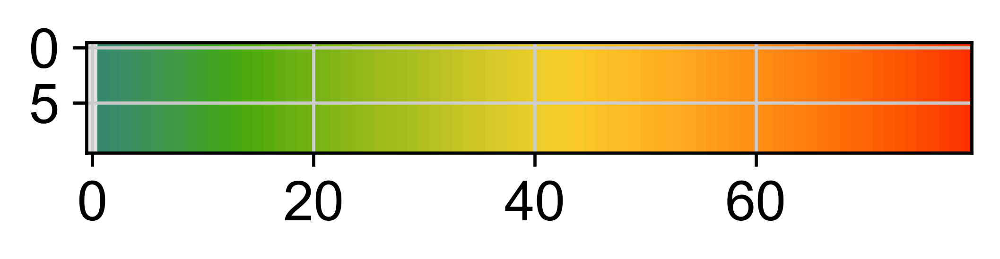

In [ ]:
import colorcet as cc

xs, _ = np.meshgrid(np.linspace(0, 1, 80), np.linspace(0, 1, 10))
colorsComb = np.vstack([pl.cm.Greys_r(np.linspace(0.8,0.1, 1)), cc.cm.rainbow_bgyr_35_85_c72(np.linspace(0.2,1, 100))])
mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)
pl.imshow(xs, cmap=mymap);  # use tab completion to choose

In [ ]:
%cd /content/

/content


In [ ]:
# add extra code to the path
!wget https://www.dropbox.com/s/xp4jrhczc0x4aa7/proportions.py
import sys
sys.path.append('/content/')
from proportions import show_values,plot_proportion_barplot_with_ncells

--2023-12-05 16:58:19--  https://www.dropbox.com/s/xp4jrhczc0x4aa7/proportions.py
Resolving www.dropbox.com (www.dropbox.com)... 162.125.85.18, 2620:100:6035:18::a27d:5512
Connecting to www.dropbox.com (www.dropbox.com)|162.125.85.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/xp4jrhczc0x4aa7/proportions.py [following]
--2023-12-05 16:58:19--  https://www.dropbox.com/s/raw/xp4jrhczc0x4aa7/proportions.py
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://ucd8eba4df8f015299628b12ef4f.dl.dropboxusercontent.com/cd/0/inline/CI3RahsDH4VQQK6vbMJejXLcEohArED1l9OO8JH66Y2LEAPjfNPT7H4fNA01CXIwHhkHMivGrPBcxP-Cx1GZmie8YuM8tTXD8fb1uj1srtvpuDIjmWi_MnN8VrDFP9OFb8s/file# [following]
--2023-12-05 16:58:20--  https://ucd8eba4df8f015299628b12ef4f.dl.dropboxusercontent.com/cd/0/inline/CI3RahsDH4VQQK6vbMJejXLcEohArED1l9OO8JH66Y2LEAPjfNPT7H4fNA01CXIwHhkHMivGrPBcxP-Cx1GZmie8YuM8tTXD8fb1uj1srtvpuDIjmW

#Print package versions

In [ ]:
%load_ext watermark
%watermark
%watermark --iversions -v -m -p numpy,scipy,sklearn,anndata,scanpy,muon,rpy2,triku

## Set global parameters

Set some plotting parameters.

In [ ]:
sc._settings.ScanpyConfig.n_jobs=8

pl.rcParams['pdf.fonttype'] = 'truetype'
sc.set_figure_params(vector_friendly=False,dpi_save=300,transparent=True)
pl.rcParams['lines.linewidth'] = 0.1
#sc.set_figure_params(color_map='viridis')
#colorsComb = np.vstack([pl.cm.Reds(np.linspace(0, 1, 10)), pl.cm.Greys_r(np.linspace(0.7, 0.8, 0))])
#mymap = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)


Set other global parameters

In [ ]:
random_state=42
# should figures just be displayed or also saved?
save_figure = False

# should cashed values be used, or recompute?
force_recompute = False

In [ ]:
#@title load accesory funtions
#@markdown
"""Functions for downstream work with outputs of remove-background."""

import tables
import numpy as np
import scipy.sparse as sp
from typing import Dict


def dict_from_h5(file: str) -> Dict[str, np.ndarray]:
    """Read in everything from an h5 file and put into a dictionary."""
    d = {}
    with tables.open_file(file) as f:
        # read in everything
        for array in f.walk_nodes("/", "Array"):
            d[array.name] = array.read()
    return d


def anndata_from_h5(file: str,
                    analyzed_barcodes_only: bool = True) -> 'anndata.AnnData':
    """Load an output h5 file into an AnnData object for downstream work.

    Args:
        file: The h5 file
        analyzed_barcodes_only: False to load all barcodes, so that the size of
            the AnnData object will match the size of the input raw count matrix.
            True to load a limited set of barcodes: only those analyzed by the
            algorithm. This allows relevant latent variables to be loaded
            properly into adata.obs and adata.obsm, rather than adata.uns.

    Returns:
        adata: The anndata object, populated with inferred latent variables
            and metadata.

    """

    try:
        import anndata
    except ImportError:
        raise ImportError('The anndata package must be installed to use the '
                          'function anndata_from_h5()')

    d = dict_from_h5(file)
    X = sp.csc_matrix((d.pop('data'), d.pop('indices'), d.pop('indptr')),
                      shape=d.pop('shape')).transpose().tocsr()

    if analyzed_barcodes_only:
        if 'barcodes_analyzed_inds' in d.keys():
            X = X[d['barcodes_analyzed_inds'], :]
            d['barcodes'] = d['barcodes'][d['barcodes_analyzed_inds']]
        elif 'barcode_indices_for_latents' in d.keys():
            X = X[d['barcode_indices_for_latents'], :]
            d['barcodes'] = d['barcodes'][d['barcode_indices_for_latents']]
        else:
            print('Warning: analyzed_barcodes_only=True, but the key '
                  '"barcodes_analyzed_inds" or "barcode_indices_for_latents" '
                  'is missing from the h5 file. '
                  'Will output all barcodes, and proceed as if '
                  'analyzed_barcodes_only=False')

    # Construct the count matrix.
    adata = anndata.AnnData(X=X,
                            obs={'barcode': d.pop('barcodes').astype(str)},
                            var={'gene_name': (d.pop('gene_names') if 'gene_names' in d.keys()
                                               else d.pop('name')).astype(str)})
    adata.obs.set_index('barcode', inplace=True)
    adata.var.set_index('gene_name', inplace=True)

    # Add other information to the adata object in the appropriate slot.
    for key, value in d.items():
        try:
            value = np.asarray(value)
            if len(value.shape) == 0:
                adata.uns[key] = value
            elif value.shape[0] == X.shape[0]:
                if (len(value.shape) < 2) or (value.shape[1] < 2):
                    adata.obs[key] = value
                else:
                    adata.obsm[key] = value
            elif value.shape[0] == X.shape[1]:
                if value.dtype.name.startswith('bytes'):
                    adata.var[key] = value.astype(str)
                else:
                    adata.var[key] = value
            else:
                adata.uns[key] = value
        except Exception:
            print('Unable to load data into AnnData: ', key, value, type(value))

    if analyzed_barcodes_only:
        for col in adata.obs.columns[adata.obs.columns.str.startswith('barcodes_analyzed')
                                     | adata.obs.columns.str.startswith('barcode_indices')]:
            try:
                del adata.obs[col]
            except Exception:
                pass

    return adata


def load_anndata_from_input_and_output(input_file: str,
                                       output_file: str,
                                       analyzed_barcodes_only: bool = True,
                                       input_layer_key: str = 'cellranger') -> 'anndata.AnnData':
    """Load remove-background output count matrix into an anndata object,
    together with remove-background metadata and the raw input counts.

    Args:
        input_file: Raw h5 file used as input for remove-background.
        output_file: Output h5 file created by remove-background (can be
            filtered or not).
        analyzed_barcodes_only: Argument passed to anndata_from_h5().
            False to load all barcodes, so that the size of
            the AnnData object will match the size of the input raw count matrix.
            True to load a limited set of barcodes: only those analyzed by the
            algorithm. This allows relevant latent variables to be loaded
            properly into adata.obs and adata.obsm, rather than adata.uns.
        input_layer_key: Key of the anndata.layer that is created for the raw
            input count matrix.

    Return:
        adata_out: AnnData object with counts before and after remove-background,
            as well as inferred latent variables from remove-background.

    """

    # Load input data.
    adata_raw = anndata_from_h5(input_file, analyzed_barcodes_only=False)

    # Load remove-background output data.
    adata_out = anndata_from_h5(output_file, analyzed_barcodes_only=analyzed_barcodes_only)

    # Subset the raw dataset to the relevant barcodes.
    adata_raw = adata_raw[adata_out.obs.index]

    # Put count matrices into 'layers' in anndata for clarity.
    adata_out.layers[input_layer_key] = adata_raw.X.copy()
    adata_out.layers['cellbender'] = adata_out.X.copy()

    # Pre-compute a bit of metadata.
    adata_out.var['n_cellranger'] = np.array(adata_out.layers['cellranger'].sum(axis=0)).squeeze()
    adata_out.var['n_cellbender'] = np.array(adata_out.layers['cellbender'].sum(axis=0)).squeeze()

    return adata_out

#load data

In [ ]:
folder = "/content/drive/MyDrive/CIP_v3_data/CIP_all/Acinar/"

if not os.path.exists(folder):
    os.makedirs(folder)

samplename='CIP_all_v3_AcinarDuctal'
random_state=42

import os
os.chdir(folder)
if not os.path.exists('./figures/'):
    os.makedirs('./figures/')

if not os.path.exists('./markers/'):
    os.makedirs('./markers/')

In [ ]:
adata=sc.read(samplename+'_Normalized_AcinarDuctal_2023-02-14.h5ad')

[autoreload of scanpy._settings failed: Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/IPython/extensions/autoreload.py", line 245, in check
    superreload(m, reload, self.old_objects)
  File "/usr/local/lib/python3.10/dist-packages/IPython/extensions/autoreload.py", line 394, in superreload
    module = reload(module)
  File "/usr/lib/python3.10/imp.py", line 315, in reload
    return importlib.reload(module)
  File "/usr/lib/python3.10/importlib/__init__.py", line 169, in reload
    _bootstrap._exec(spec, module)
  File "<frozen importlib._bootstrap>", line 619, in _exec
  File "<frozen importlib._bootstrap_external>", line 883, in exec_module
  File "<frozen importlib._bootstrap>", line 241, in _call_with_frames_removed
  File "/usr/local/lib/python3.10/dist-packages/scanpy/_settings.py", line 13, in <module>
    from ._compat import Literal
ImportError: cannot import name 'Literal' from 'scanpy._compat' (/usr/local/lib/python3.10/dist-packages/s

In [ ]:
adata.obs['annotated'] = adata.obs['annotated'].replace({'ADM late': 'ADM-late', 'ADM early': 'ADM-early'})


In [ ]:
adata_all=sc.read('/content/drive/MyDrive/CIP_v3_data/CIP_all/FullDataset/datasets/CIP_all_v3_no_W6_8__filteredNormalized_annotated_2023-02-14.h5ad')

/usr/local/lib/python3.10/dist-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.


In [ ]:
fm.rcParams['font.family']=['Arial']
sb.set_context('talk')
#pl.rcParams['figure.figsize']=(15,15)
pl.rcParams['figure.dpi']=200

#Color formatting

##cell type

In [ ]:
adata

In [ ]:
###final colors -- dictionary for
color_dict={
    'Acinar':'#d62728',#'#9a133d',, dark green
    'ADM-late': '#ff7f0e',#'#92ab1e', green
    'ADM-early': '#e377c2',
    'Macrophage / DC': '#4060c8',#green'#1f77b4',
    'Fibroblast': '#7aaa6f',
    'Endothelial':'#F4BB44', #'#d62728',#c49c94',#green'#c7d8a9',
    'Neutrophil': '#a1c2ed',
    'Ductal': '#aa40fc',
    'B': '#17becf',
    'T / NK': '#6996e3',#green'#366938',#'#79daea', blue
    'Pericyte': '#CF9FFF',
    'Endocrine': '#8c564b',
    'Schwann': '#c49c94',
    'Mesothelial': '#355E3B'}


In [ ]:
category_colors = []
for category in adata.obs['annotated'].cat.categories:
    color = color_dict[category]
    category_colors.append(color)

In [ ]:
adata.obs['annotated']= adata.obs['annotated'].cat.reorder_categories(['Acinar','ADM-early','ADM-late','Ductal'])

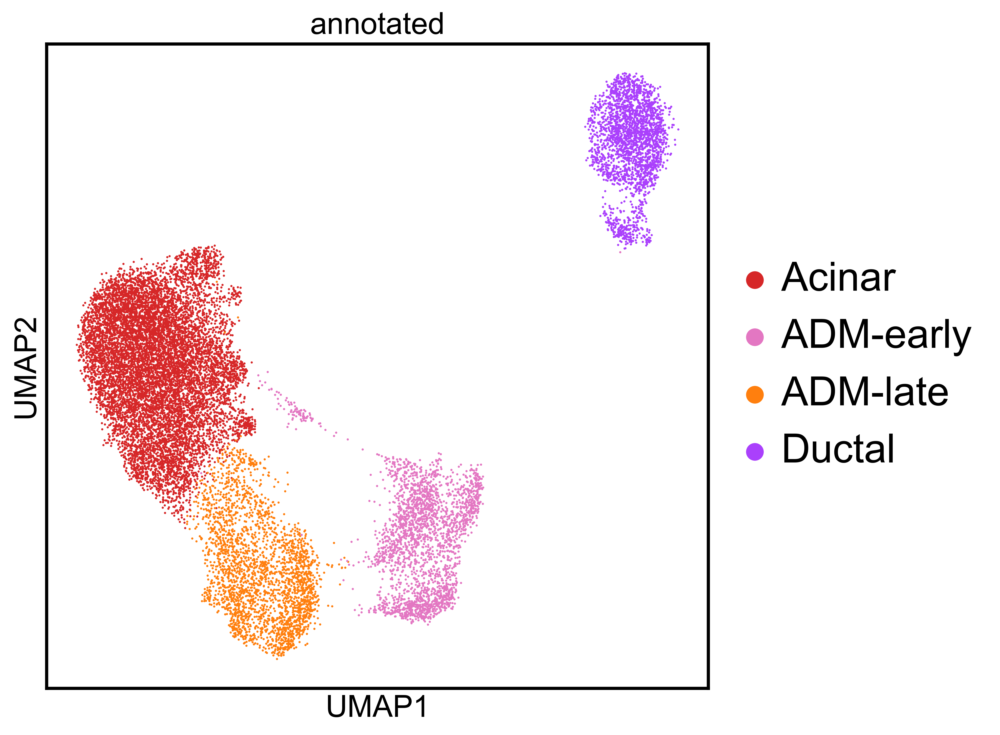

In [ ]:
fm.rcParams['font.family']=['Arial']
sb.set_context('talk')
pl.rcParams['figure.figsize']=(7,7)
pl.rcParams['figure.dpi']=300
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
#savefig=samplename+"_annotated_hires_annotated.pdf"
sc.pl.umap(adata, color=['annotated'], palette=category_colors,legend_loc='right margin',legend_fontoutline=3,vmax='p99.9',legend_fontsize=24, legend_fontweight='normal',frameon=True)

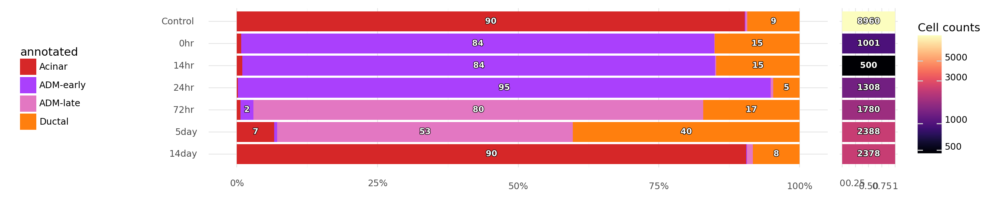

In [ ]:
 fig=plot_proportion_barplot_with_ncells(
    adata,
    'sample',
    fill='annotated',
    fill_breakdown=None,
    yaxis_label=None,
    fill_label='annotated',
    percent_limit=2.,
    show_percent=True,
    height_scale=1.,
    width_scale=1.,
    legend_position=(-0.05, 0.5),
    normalize_by=None,)

##Sample

In [ ]:
colors_time=['#88a0dc', '#381a61', '#7c4b73', '#ed968c', '#ab3329', '#e78429', '#f9d14a']

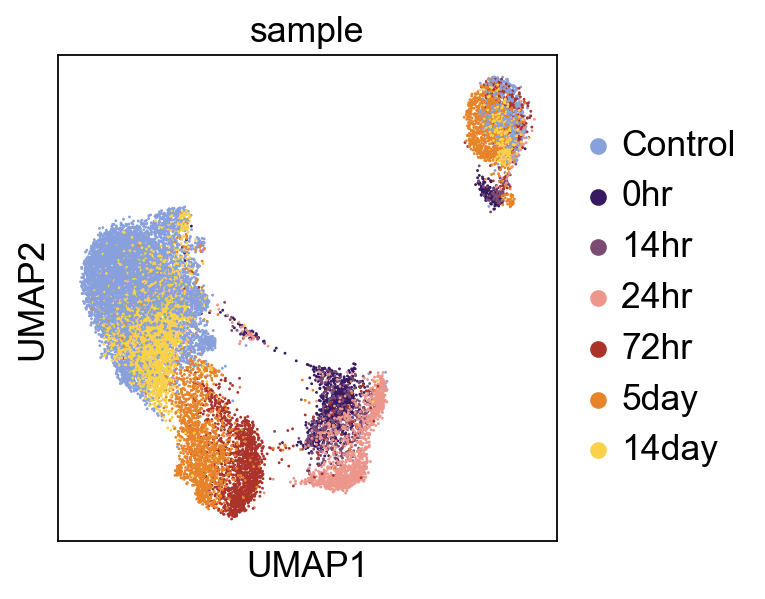

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(7,7)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
#savefig=samplename+"_annotated_hires_annotated.pdf"
sc.set_figure_params(fontsize=16)
sc.pl.umap(adata, color=['sample'], palette=colors_time,legend_loc='right margin',legend_fontoutline=3,vmax='p99.9',legend_fontsize=16, legend_fontweight='normal',frameon=True)

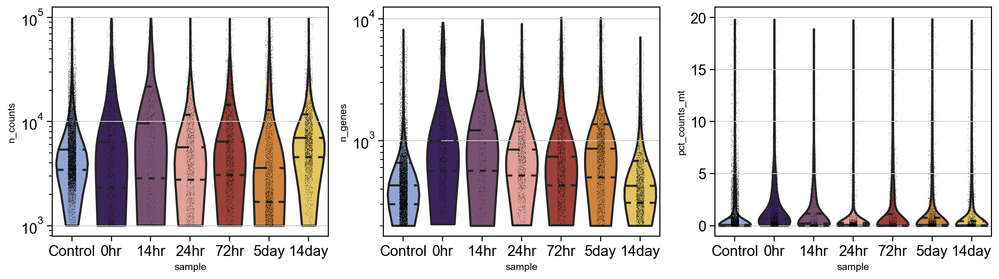

In [ ]:
sb.set_context('paper')
pl.rcParams['lines.linewidth'] = 0.1
import matplotlib.pyplot as plt

fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(16,4), gridspec_kw={'wspace':0.2})

ax1_dict = sc.pl.violin(adata, 'n_counts', groupby='sample', jitter=0.1, linewidth=2, alpha=0.25, inner="quartile", size=0.3, log=True, cut=0, ax=ax1, show=False)
ax2_dict =  sc.pl.violin(adata, 'n_genes', groupby='sample', jitter=0.1, linewidth=2, alpha=0.25, inner="quartile", size=0.3, log=True, cut=0, ax=ax2, show=False)
ax3_dict = sc.pl.violin(adata, 'pct_counts_mt', groupby='sample',jitter=0.1, linewidth=2, alpha=0.25, inner="quartile",size=0.3, ax=ax3, show=False,)

ax1.tick_params(axis='both', which='major', labelsize=14)
ax2.tick_params(axis='both', which='major', labelsize=14)
ax3.tick_params(axis='both', which='major', labelsize=14)

#ADMI scoring

##Full dataset

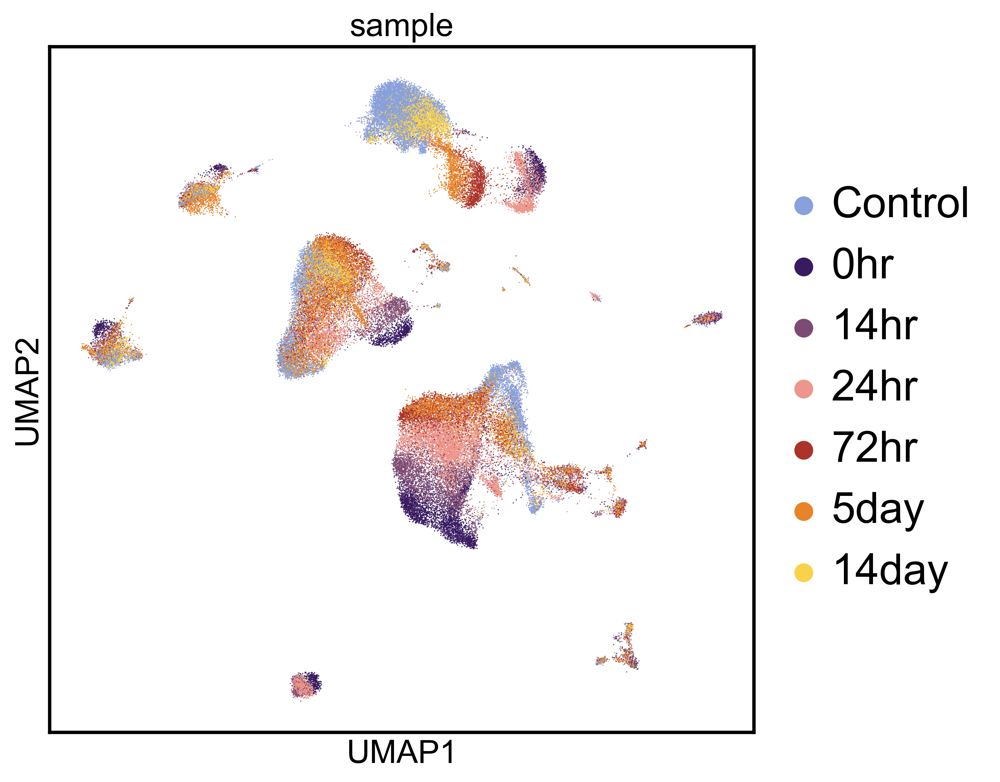

In [ ]:
sb.set_context('talk')
pl.rcParams['figure.figsize']=(7,7)
#sc.tl.leiden(adata,random_state=random_state, resolution = 0.5)
#savefig=samplename+"_annotated_hires_annotated.pdf"
sc.pl.umap(adata_all, color=['sample'], palette=colors_time,legend_loc='right margin',legend_fontoutline=3,vmax='p99.9',legend_fontsize=24, legend_fontweight='normal',frameon=True)

In [ ]:
ADMi={
    'Prss3','Gm2663', '1810009J06Rik', 'Gm5771', 'Prss1','Gm4744','Gm10334',
    'Reg2', 'Reg3b', 'Reg3g','Reg3a',
    'Krt18','Krt8', 'Krt19',
    'Tspan1','Cldn4'
}

In [ ]:
adata_all.X=adata_all.layers['PFlog1pPF_normalization']
sc.tl.score_genes(adata_all, ADMi, ctrl_size=500, use_raw=False,score_name="ADM score")

In [ ]:
pl.rcParams['font.family']=['Arial']
sb.set_context('talk')
pl.rcParams['figure.dpi']=200

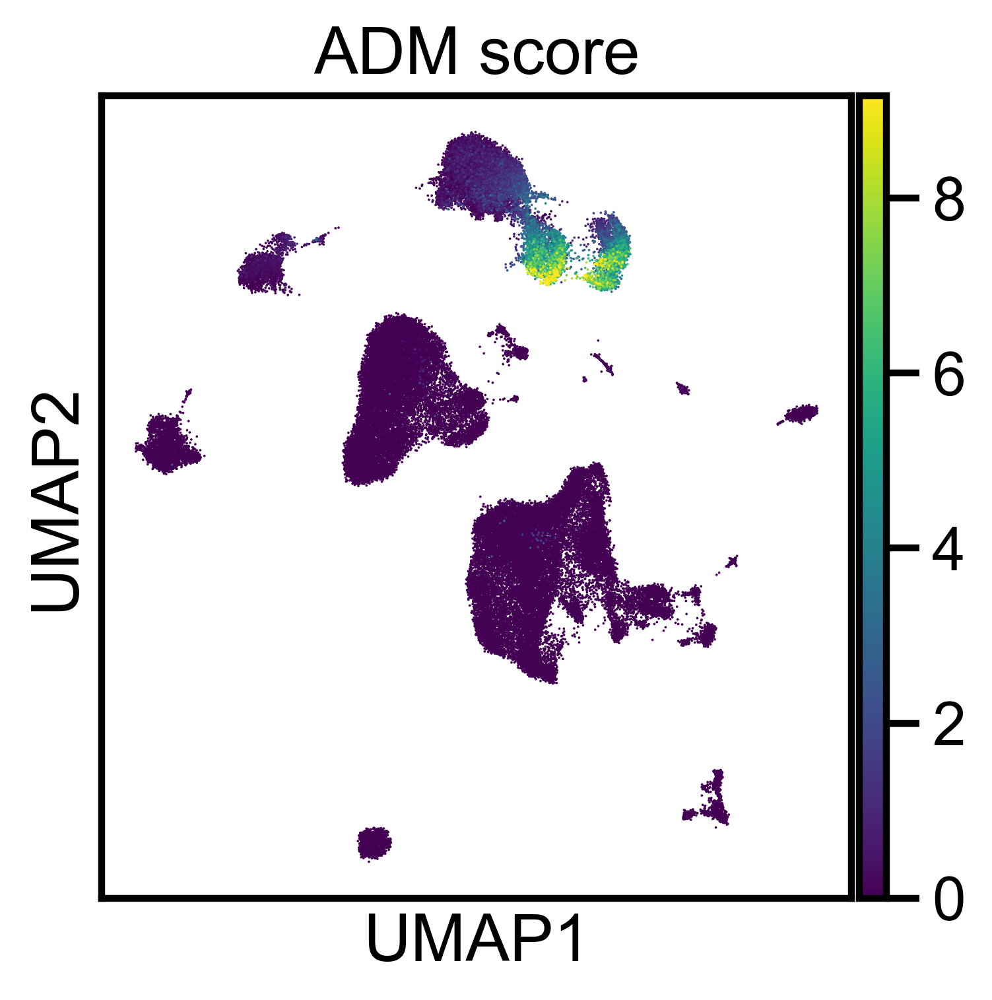

In [ ]:
# Set the figure size
plt.rcParams['figure.figsize'] = (4, 4)

# Create the UMAP plot with the specified color scale
sc.pl.umap(adata_all, color="ADM score", frameon=True,sort_order=True, vmin=0, vmax='p99.9')


In [ ]:
adata_all

##Acinar only

In [ ]:
#Acinar only
acinar= adata_all[adata_all.obs['annotated'].isin(['Acinar']),:].copy()
acinar

In [ ]:
# Convert the .obs attribute of the AnnData object to a pandas DataFrame
acinar_df = pd.DataFrame(acinar.obs)

# Group the DataFrame by 'donor' and compute the median 'ADM score' for each group
median_adm_scores = acinar_df.groupby('donor')['ADM score'].median().reset_index()

# Merge the median_adm_scores DataFrame with the original acinar_df DataFrame to include the 'sample' category
result = acinar_df[['donor', 'sample']].drop_duplicates().merge(median_adm_scores, on='donor', how='left')

# Display the resulting DataFrame
print(result)


        donor   sample  ADM score
0   control_1  Control  -0.002060
1   control_2  Control  -0.043582
2   control_3  Control   0.323754
3   control_4  Control  -0.099654
4       0hr_1      0hr   3.589614
5       0hr_2      0hr   3.018185
6      14hr_1     14hr   3.379688
7      14hr_2     14hr   4.391094
8      24hr_1     24hr   3.554225
9      24hr_2     24hr   4.357907
10     72hr_1     72hr   4.746731
11     72hr_2     72hr   4.097228
12     5day_2     5day   2.086771
13     5day_1     5day   3.526719
14    14day_1    14day   0.402125
15    14day_2    14day   0.775270
16  control_5  Control  -0.073201


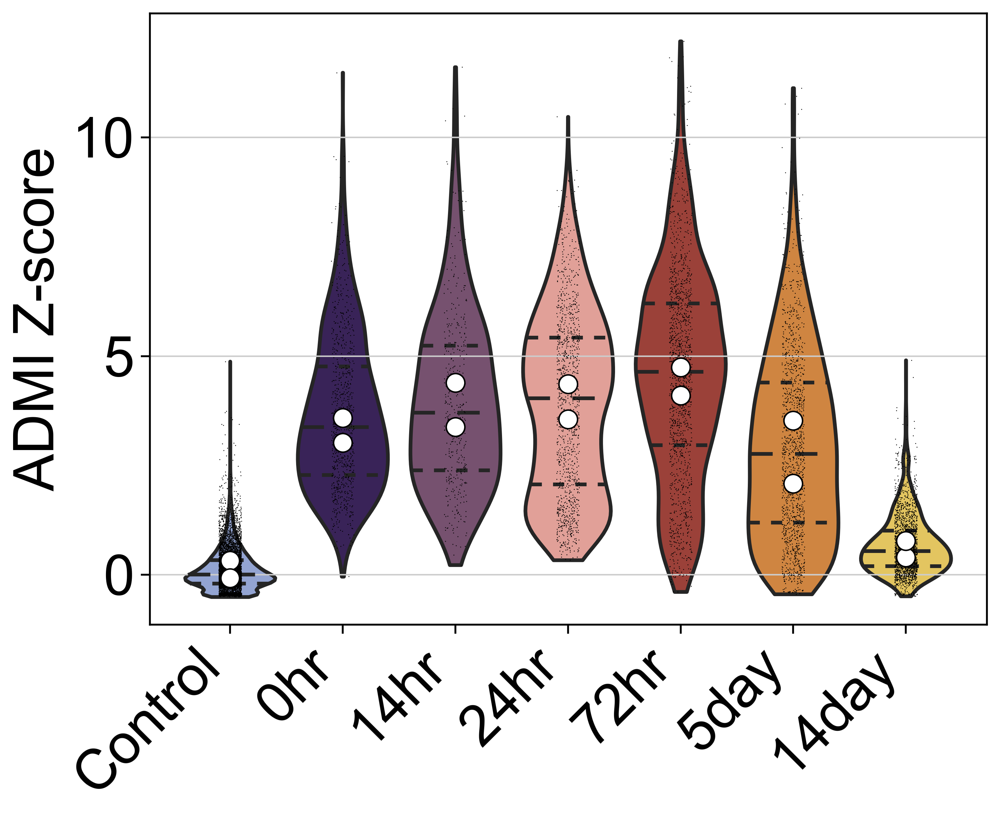

In [ ]:
sb.set_context('paper')
plt.rcParams['lines.linewidth'] = 0.1

fig, (ax1) = plt.subplots(1, 1, figsize=(8, 6), gridspec_kw={'wspace': 0.2})

ax1_dict = sc.pl.violin(acinar, "ADM score", groupby='sample', jitter=0.1, linewidth=2, alpha=0.25, inner="quartile", size=0.5, cut=0, ax=ax1, show=False)
ax1.set_xticklabels(ax1.get_xticklabels(), rotation=45, ha='right')
ax1.tick_params(axis='both', which='major', labelsize=30)
ax1.set_ylabel('ADMI Z-score', fontsize=30)
ax1.set_xlabel('')

# Assuming 'result' DataFrame is available from the previous steps
# Get the unique sample names and their corresponding indices
unique_samples = result['sample'].unique()
sample_indices = {sample: i for i, sample in enumerate(unique_samples)}

# Overlay the white dots representing the 'median_ADM_score' by 'sample'
for _, row in result.iterrows():
    sample = row['sample']
    median_adm_score = row['ADM score']
    x = sample_indices[sample]
    ax1.scatter(x, median_adm_score, c='white', edgecolor='black', s=100, zorder=10)

plt.show()


#Acute vs chronic pancreatitis marker genes

In [ ]:
adata_ADM=sc.read('/content/drive/MyDrive/Comparing_ADM/NissimAllCells+ADM_CIP_NissimMa_annotated_umap_triku_20231016.h5ad')

/usr/local/lib/python3.10/dist-packages/anndata/__init__.py:51: FutureWarning: `anndata.read` is deprecated, use `anndata.read_h5ad` instead. `ad.read` will be removed in mid 2024.


In [ ]:
gene_list=['Hmgn1', #Protein-containing complex binding
             'Tagln2','Snrpf', '2410006H16Rik','Gm15564','Pabpn1','Zfas1',
             'Hexb',#cell motility,Protein-containing complex binding,Extracellular space
             'Sh3bgrl3',
             'Cd9',#LABLED #motility, wound healing, extracellular space, Protein-containing complex binding
             '1110038B12Rik',
             'Clic1',  #LABLED #extracellular space
             'Bzw1', 'Fdps', 'Efhd2', 'Plp2', 'Snhg12',  'Cnih4', 'Ethe1', 'Sat1', 'Psme1', 'Lrrfip2', 'Pmm1',
             'Tspo', #hormone stimulus, motility, protein/macromolecule localization
             'Tnfrsf12a', #labeled #motility, wound healing
             'Sfn', '2200002D01Rik',
             'Lgals3', #cell motility, extracellular space,protein/macromolecule localization
              'Rtn4',
           ]



# # Check if the gene list is in the var_names
# assert all(gene in adata_ADM.var_names for gene in gene_list), "Some genes are not in `adata`"

# Filter the AnnData object for the '0hr' sample
adata_filtered = adata1[adata1.obs['sample'] == '0hr']

# Get the mean expression for each gene in 'gene_list'
gene_expression = {gene: np.mean(adata_filtered[:, gene].X) for gene in gene_list}

# Sort the genes by their mean expression level
sorted_genes = sorted(gene_expression, key=gene_expression.get, reverse=True)  # High to low

print(sorted_genes)

['Tagln2', 'Lgals3', 'Clic1', 'Sfn', 'Efhd2', 'Rtn4', 'Sat1', 'Sh3bgrl3', 'Fdps', 'Pmm1', 'Cd9', 'Tnfrsf12a', '2410006H16Rik', 'Bzw1', 'Hmgn1', 'Pabpn1', 'Tspo', 'Cnih4', 'Lrrfip2', 'Hexb', 'Gm15564', 'Plp2', '2200002D01Rik', 'Snrpf', 'Psme1', 'Ethe1', '1110038B12Rik', 'Zfas1', 'Snhg12']


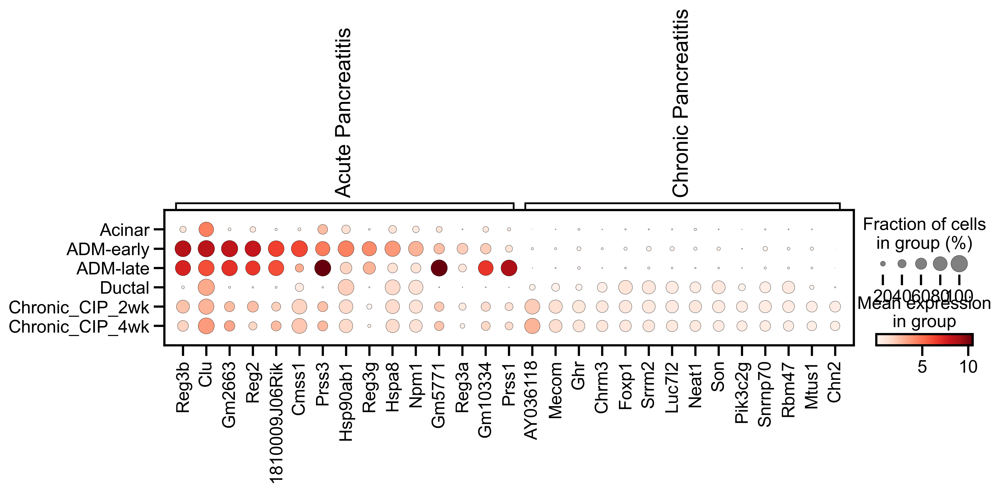

In [ ]:
all={
    'Acute Pancreatitis':['Reg3b', 'Clu', 'Gm2663', 'Reg2', '1810009J06Rik', 'Cmss1', 'Prss3', 'Hsp90ab1', 'Reg3g', 'Hspa8', 'Npm1', 'Gm5771', 'Reg3a', 'Gm10334', 'Prss1'],
    'Chronic Pancreatitis':['AY036118', 'Mecom', 'Ghr', 'Chrm3', 'Foxp1', 'Srrm2', 'Luc7l2', 'Neat1', 'Son', 'Pik3c2g', 'Snrnp70', 'Rbm47', 'Mtus1', 'Chn2']
    }

sc.pl.dotplot(adata_ADM,all,"annotated",layer='PFlog1pPF_normalization',#swap_axes=True
              )


#Marker genes

<Figure size 1000x1000 with 0 Axes>

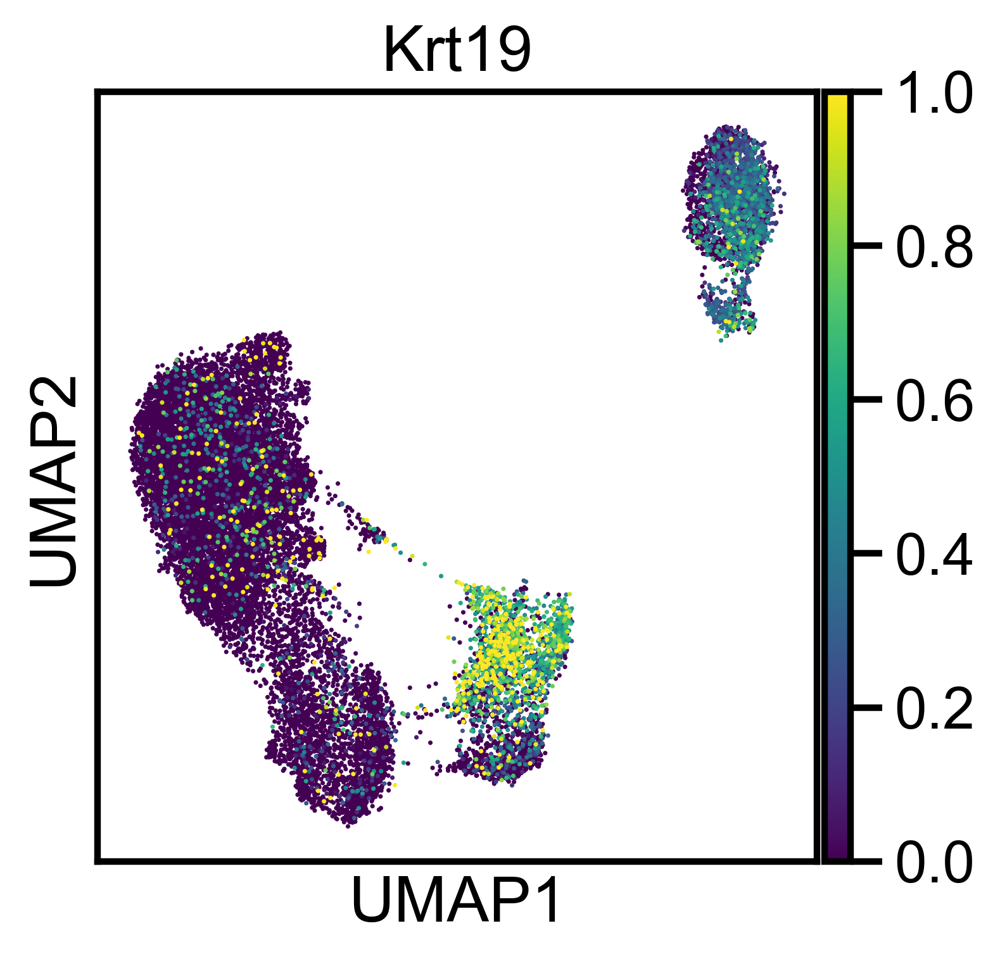

In [ ]:
# Set the figure size using Matplotlib
plt.figure(figsize=(5, 5))

# Now call the UMAP plot function without the figsize argument
sc.pl.umap(adata, color=['Krt19'], legend_loc='right margin', legend_fontoutline=3, legend_fontsize=16, legend_fontweight='normal', frameon=True, layer='PFlog1pPF_normalization', vmax=1)

# Show the plot
plt.show()

<Figure size 1000x1000 with 0 Axes>

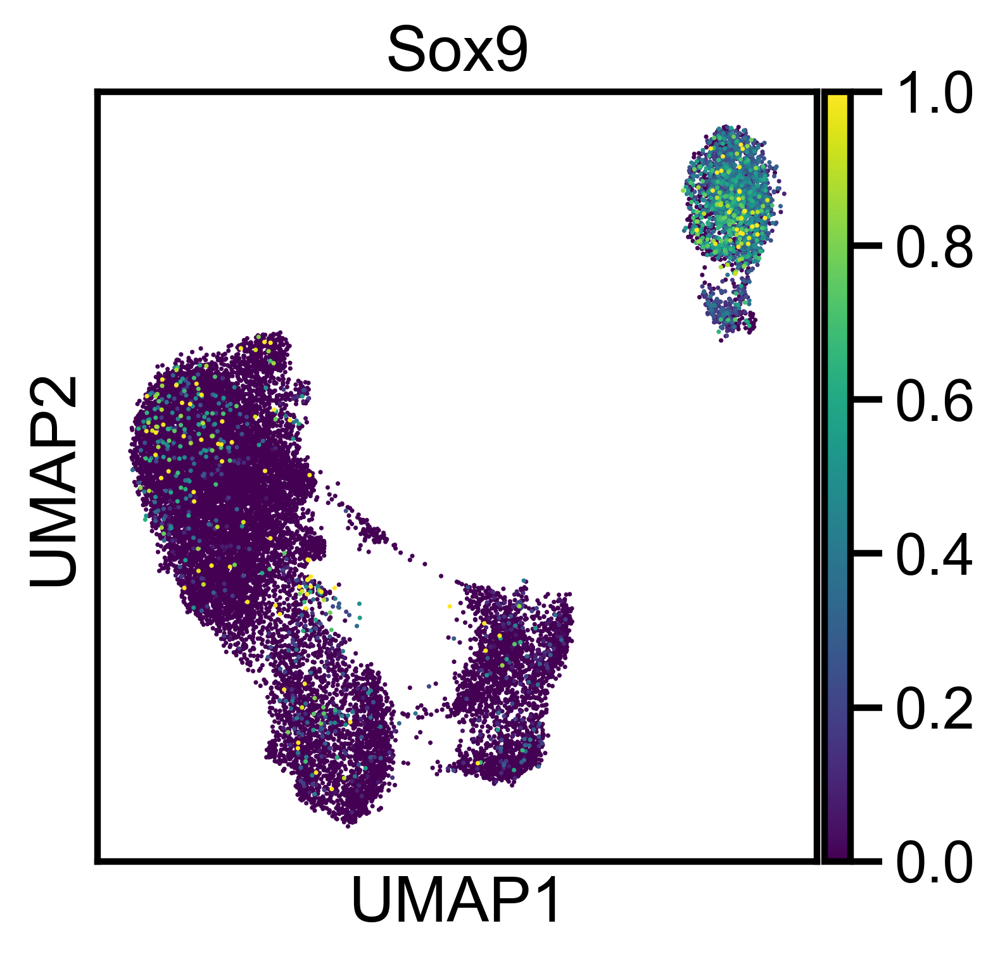

In [ ]:
# Set the figure size using Matplotlib
plt.figure(figsize=(5, 5))

# Now call the UMAP plot function without the figsize argument
sc.pl.umap(adata, color=['Sox9'], legend_loc='right margin', legend_fontoutline=3, legend_fontsize=16, legend_fontweight='normal', frameon=True, layer='PFlog1pPF_normalization', vmax=1)

# Show the plot
plt.show()

<Figure size 1000x1000 with 0 Axes>

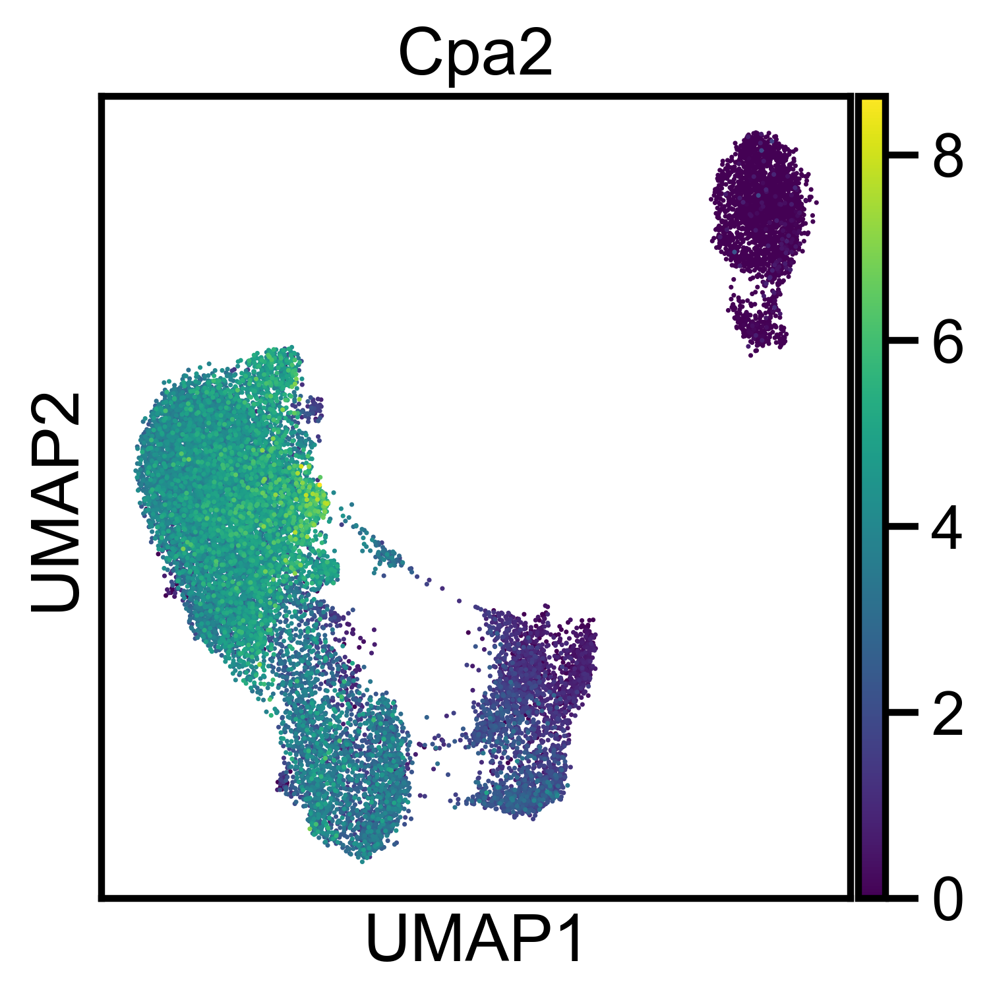

In [ ]:
# Set the figure size using Matplotlib
plt.figure(figsize=(5, 5))

# Now call the UMAP plot function without the figsize argument
sc.pl.umap(adata, color=['Cpa2'], legend_loc='right margin', legend_fontoutline=3, legend_fontsize=16, legend_fontweight='normal', frameon=True, layer='PFlog1pPF_normalization')

# Show the plot
plt.show()

<Figure size 1000x1000 with 0 Axes>

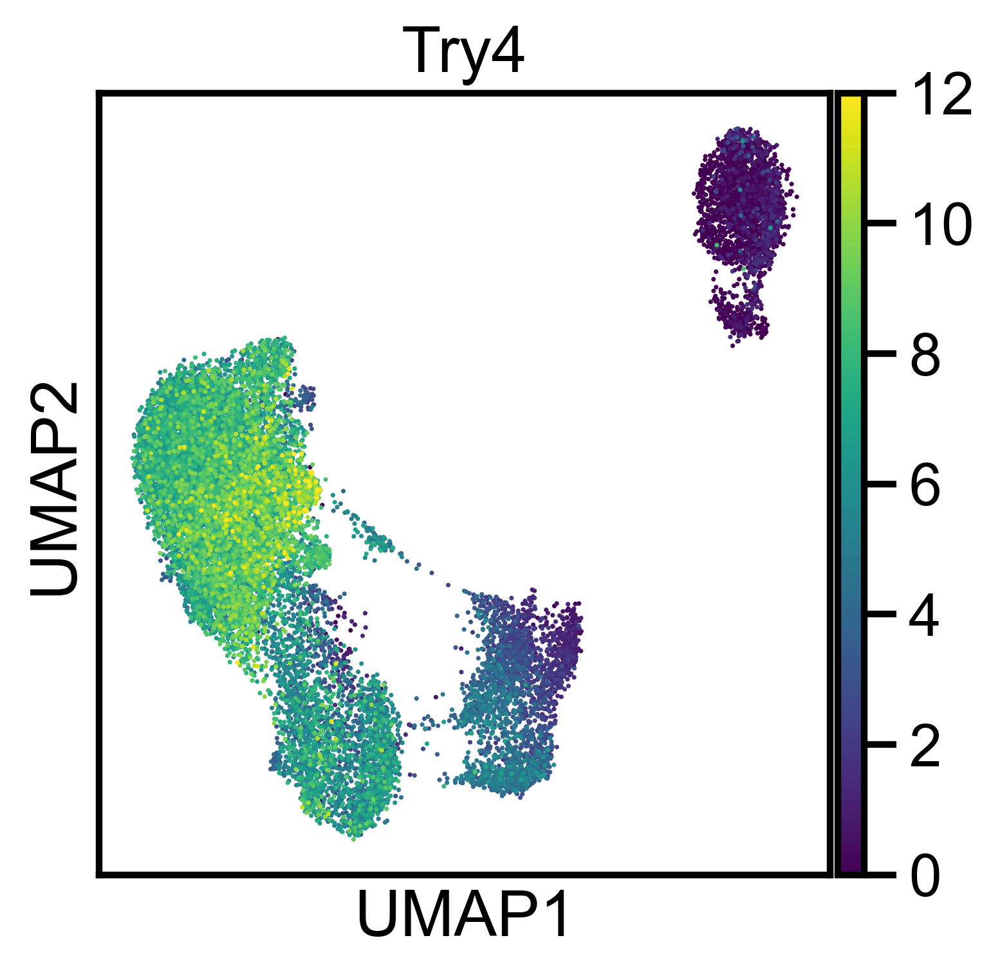

In [ ]:
# Set the figure size using Matplotlib
plt.figure(figsize=(5, 5))

# Now call the UMAP plot function without the figsize argument
sc.pl.umap(adata, color=['Try4'], legend_loc='right margin', legend_fontoutline=3, legend_fontsize=16, legend_fontweight='normal', frameon=True, layer='PFlog1pPF_normalization', vmax=12)

# Show the plot
plt.show()

In [ ]:
markers={'Acinar': ['Ctrb1','Prss2','Sycn','Pnlip'], #'Cpa1','Tff2'
         'Ductal':['Krt8','Krt18','Spp1','Epcam']} #'Spp1'

markerslist= ['Ctrb1','Prss2','Sycn','Pnlip','Krt8','Krt18','Spp1','Epcam']

In [ ]:
adata.obs['annotated']= adata.obs['annotated'].cat.reorder_categories(['Acinar','ADM-late','ADM-early','Ductal'])

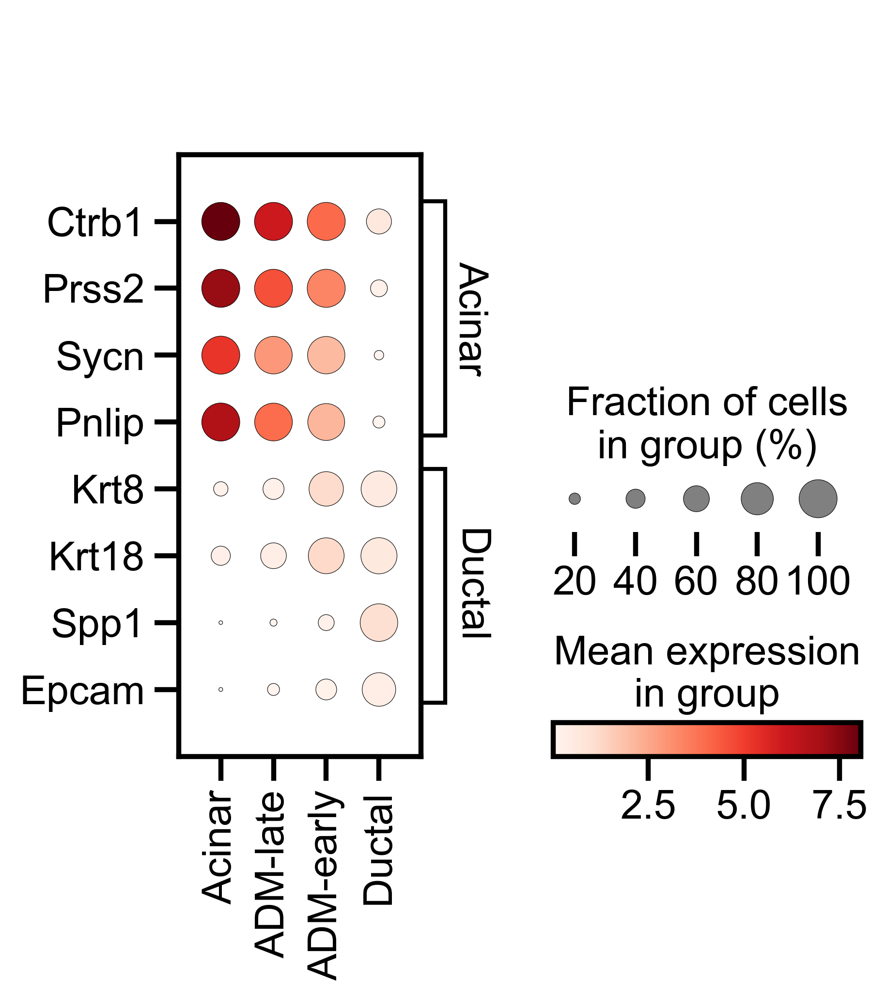

In [ ]:
fm.rcParams['font.family']=['Arial']
#sb.set_context('talk')
#sc.settings.set_figure_params(dpi=200, figsize=(12,4), fontsize=14)
fig, ax=plt.subplots(figsize=(11,5))
plt.subplots_adjust(right=0.5)
sc.pl.dotplot(adata,markers
              ,"annotated",layer='PFlog1pPF_normalization',dendrogram=False, ax=ax,swap_axes=True, show=False)
plt.show()

#Plotting pathway analysis

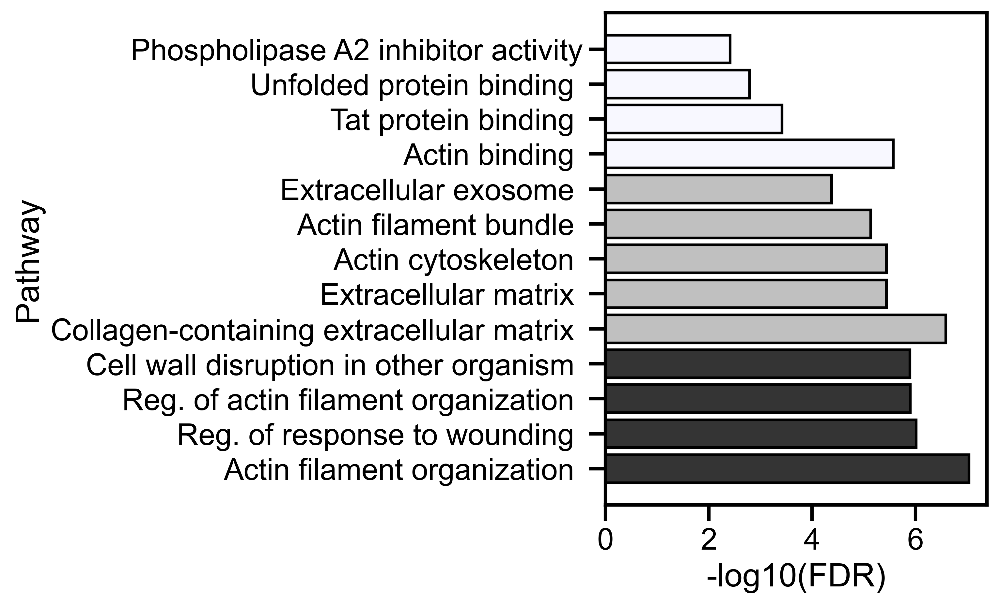

In [ ]:
# Read data
df = pd.read_csv('/content/drive/MyDrive/CIP_v3_data/CIP_all/FullDataset/Acinar_pathways_2023-11-10.csv')

# Remove any rows with NaN values in the 'nGenes' column
df = df.dropna(subset=['nGenes'])

# Define a color palette (you can choose different colors)
color_palette = {'Biological Process': '#343434', 'Cellular Component': '#C0C0C0', 'Molecular Function': '#F8F8FF'}

# Map the 'GO' column to the color palette
df['color'] = df['GO'].map(color_palette)

# Create the figure and axes objects
fig, ax = plt.subplots(figsize=(8, 5))

# Make a horizontal bar plot colored by 'GO' category
bars = ax.barh(df['Pathway'], -np.log10(df['Enrichment FDR']), color=df['color'], edgecolor='black')

# Set labels and title
ax.set_xlabel('-log10(FDR)')
ax.set_ylabel('Pathway')

plt.tight_layout()
ax.grid(False)
plt.show()

In [ ]:
from matplotlib.patches import Patch

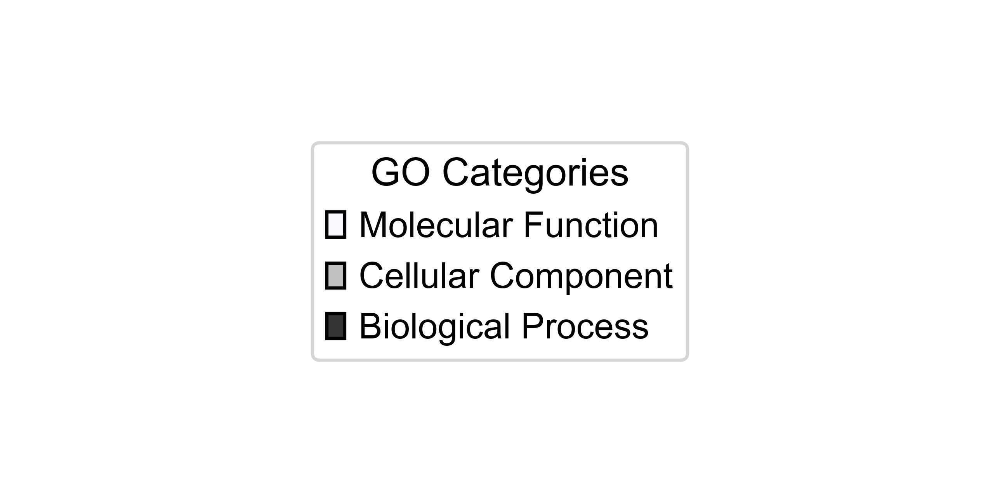

In [ ]:
# Define a color palette (you can choose different colors)
color_palette = { 'Molecular Function': '#F8F8FF', 'Cellular Component': '#C0C0C0','Biological Process': '#343434'}

# Create a figure and an axis (which we won't actually use for plotting)
fig, ax = plt.subplots(figsize=(8, 4))  # Adjust the size as needed

# Hide the actual plot axes
ax.axis('off')

# Create a legend for the color palette
legend_elements = [Patch(facecolor=color_palette[key], edgecolor='black', label=key) for key in color_palette]
ax.legend(handles=legend_elements, title='GO Categories', loc='center')

# Show the figure
plt.show()

#Acinar only

In [ ]:
#Acinar only
adata1= adata[adata.obs['annotated'].isin(['Acinar', 'ADM-early', 'ADM-late']),:].copy()
adata1

In [ ]:
#method : {‘logreg’, ‘t-test’, ‘wilcoxon’, ‘t-test_overestim_var’} | None (default: None)
sc.tl.rank_genes_groups(adata1, 'annotated', method='wilcoxon',n_genes=adata1.shape[1],layer='PFlog1pPF_normalization', rankby_abs=False,corr_method='bonferroni',key_added=f"wilcoxon_rank_groups_annotated" )

In [ ]:
wilcoxon=pd.DataFrame(adata1.uns[f"wilcoxon_rank_groups_annotated"]['names']).head(100)
wilcoxon

,Acinar,ADM-early,ADM-late
0,Tff2,Cmss1,Prss1
1,Sycn,Gm2663,Gm5771
2,Pnlip,Camk1d,Prss3
3,Prss2,Hsp90ab1,1810009J06Rik
4,Cela1,1810009J06Rik,Gm2663
...,...,...,...
95,Rpl3,Gng5,Pycr2
96,Gcat,Sem1,Tmsb4x
97,Amy2a1,Map1lc3a,Ndufb6
98,Nme2,Ldha,Cox7b


In [ ]:
#set markers
markers1=wilcoxon.to_dict('list')
markers1

###trans/dedifferentiation markers
from reviewer request

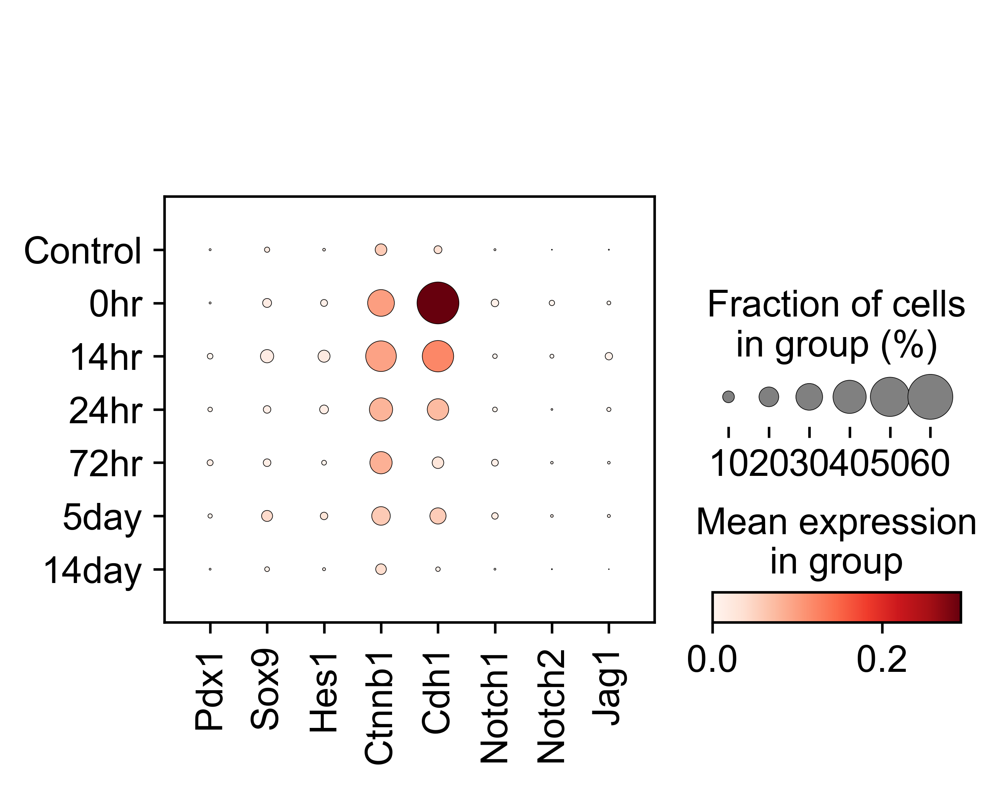

In [ ]:
sc.pl.dotplot(adata1,['Pdx1','Sox9','Hes1','Ctnnb1','Cdh1','Notch1','Notch2','Jag1'],"sample",layer='PFlog1pPF_normalization',var_group_rotation=0, vmin= 0)

##complexity of acinar cells

In [ ]:
adata.obs['complexity'] = adata.obs['n_genes'] / adata.obs['n_counts']

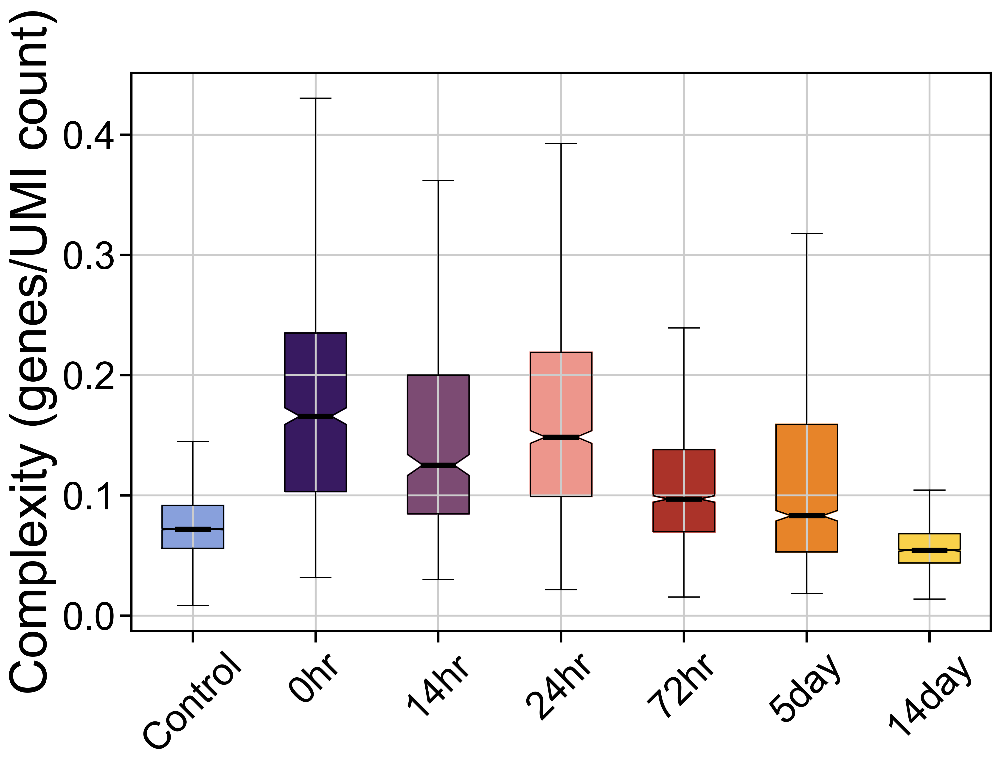

In [ ]:
import matplotlib.pyplot as plt
samplename = adata1.obs["sample"].unique().tolist()
counts = [adata1[adata1.obs["sample"] == sample].obs["complexity"].tolist() for sample in samplename]

fig, ax = plt.subplots(figsize=(12, 8))
bplot=ax.boxplot(counts, notch=True, medianprops={"linewidth": 4, "color":'black'},positions=[x for x in range(len(samplename))],sym='')

# Increase font size
ax.set_xticklabels(samplename, fontsize=30)
plt.xticks(rotation=90)
ax.set_ylabel("Complexity (genes/UMI count)", fontsize=40)
ax.tick_params(axis='y', which='major', labelsize=30)
ax.tick_params(axis='x', which='major', labelsize=30, rotation=45)

import matplotlib.patches as mpatches
# fill with colors
for artist, color in zip(bplot['boxes'], colors_time):
    patch = mpatches.PathPatch(artist.get_path(), color=color)
    ax.add_artist(patch)



plt.show()

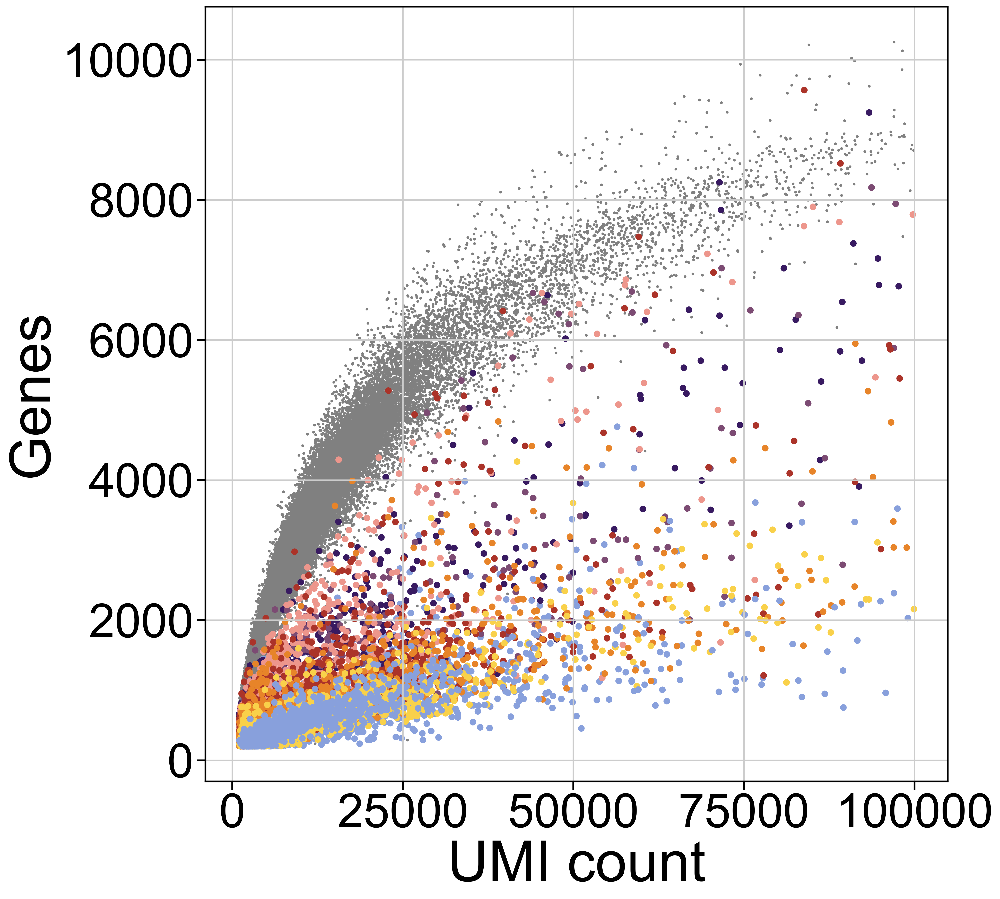

In [ ]:
#QC plots by celltype
celltype=['Acinar']
for x in celltype:
  subset= adata_all[adata_all.obs['annotated'].isin([x]),:].copy()
  fig, ax = plt.subplots(figsize=(14, 15))
  #plt.axvline(x=50000, color='red', linewidth=2)

  color_labels = subset.obs['sample'].cat.codes
  colors = [adata.uns['sample_colors'][i] for i in color_labels]
  color_labels_values = subset.obs['sample'].cat.categories.tolist()

  plt.scatter(adata_all.obs['total_counts'], adata_all.obs['n_genes'], c='grey', label='all cells', alpha=1, s=2)
  plt.scatter(subset.obs['total_counts'], subset.obs['n_genes'], c=colors,label=color_labels_values,s=30)
  #plt.title(x+' Total Counts vs Number of Genes',fontsize=55)
  plt.xlabel('UMI count',fontsize=60)
  plt.ylabel('Genes',fontsize=60)
  plt.tick_params(axis='both', which='major', labelsize=50)


  #legend_handles = [mpl.lines.Line2D([], [], marker="o", markersize=2, color=cmap(i), linewidth=0) for i in np.unique(color_labels)]
  #plt.legend(legend_handles, color_labels_values, loc='best', markerscale=3)

  plt.show()

##Gene dotplots

In [ ]:
adata1.layers["counts"] = adata1.layers['cellbender']
adata1.X=adata1.layers["counts"]
#adata.layers["sqrt_norm"] = np.sqrt(sc.pp.normalize_total(adata, inplace=False,target_sum=1e4)["X"])
adata1.layers["log_norm"]=sc.pp.log1p(sc.pp.normalize_total(adata1,inplace=False,target_sum=1e4)["X"])
# proportional fitting to mean of cell depth
proportional_fitting = sc.pp.normalize_total(adata1, target_sum=None, inplace=False)
# log1p transform
adata1.layers["log1pPF_normalization"] = sc.pp.log1p(proportional_fitting["X"])

In [ ]:
adata1.layers["PFlog1pPF_normalization"] = sc.pp.normalize_total(adata1, target_sum=None, layer="log1pPF_normalization", inplace=False)["X"]


In [ ]:
ADMi={
    'Trypsinogens':['Gm2663', '1810009J06Rik','Gm4744','Prss3','Gm5771','Gm10334','Prss1'],
    'Reg':['Reg2', 'Reg3b', 'Reg3g','Reg3a'],
    'Ductal':['Krt18','Krt8', 'Krt19'],
    'Other':['Tspan1','Cldn4']
}


In [ ]:
adata_all.obs['annotated_ADM'] = adata_all.obs['annotated_ADM'].replace(['Macrophage / DC', 'Neutrophil','B','T / NK'], 'Immune')
adata_all.obs['annotated_ADM'] = adata_all.obs['annotated_ADM'].replace(['Schwann'], 'Fibroblast')
adata_all.obs['annotated_ADM'] = adata_all.obs['annotated_ADM'].replace(['Pericyte'], 'Endothelial')
adata_all.obs['annotated_ADM'] = adata_all.obs['annotated_ADM'].replace(['ADM early'], 'ADM-early')
adata_all.obs['annotated_ADM'] = adata_all.obs['annotated_ADM'].replace(['ADM late'], 'ADM-late')


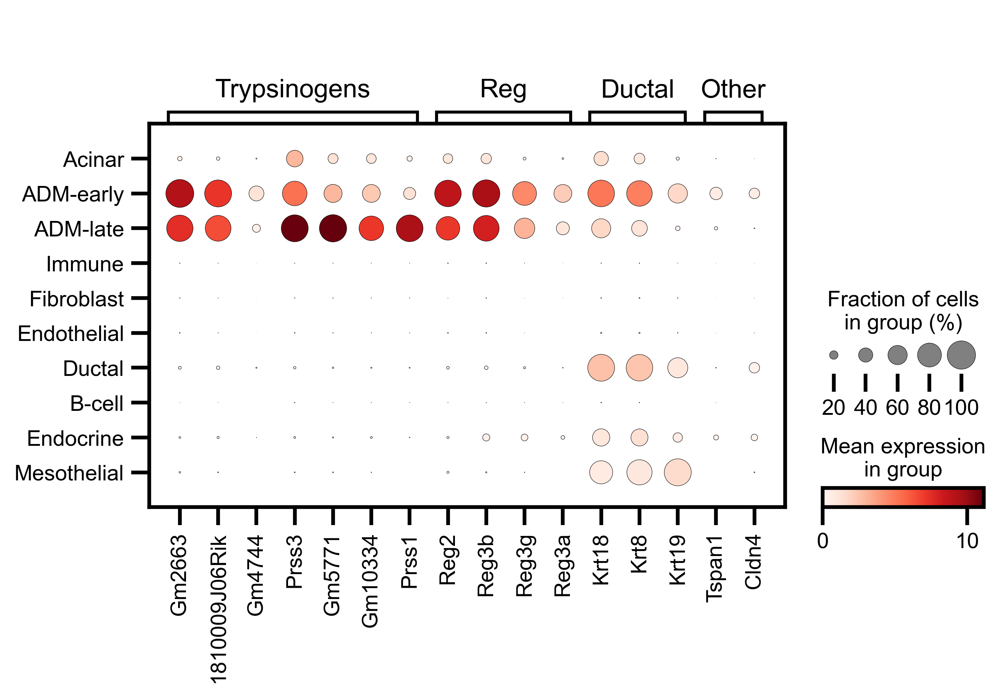

In [ ]:
##top genes from acinar, ADM, ductal

# Set the font size globally for all axes
plt.rcParams.update({'font.size': 13})

sc.pl.dotplot(adata_all,ADMi,"annotated_ADM",layer='PFlog1pPF_normalization',var_group_rotation=0)

# Show the updated plot
plt.show()

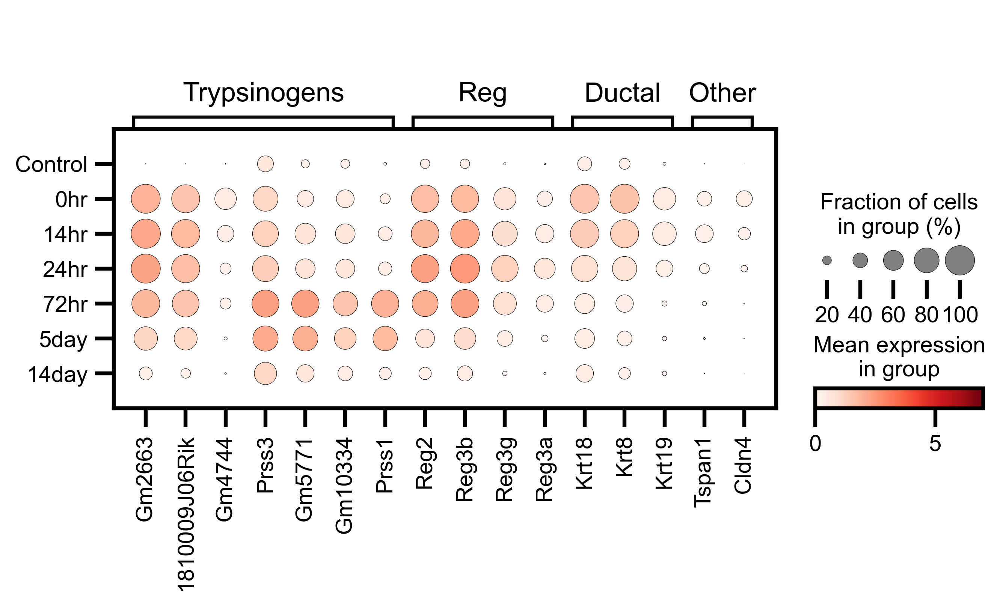

In [ ]:
sc.pl.dotplot(adata1,ADMi,"sample",layer='PFlog1pPF_normalization',var_group_rotation=0, vmin= 0, vmax= 7)

In [ ]:
marker_genes ={
          'Proteases': ['Ctrb1','Cela1','Cela3b','Ctrl'],
    'Healthy trypsinogens': ['Prss2','Try4','2210010C04Rik','Try5']}

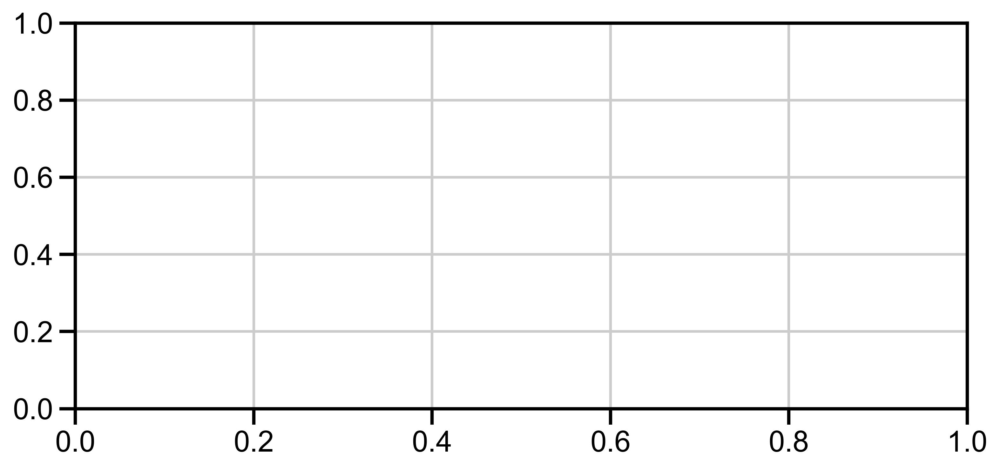

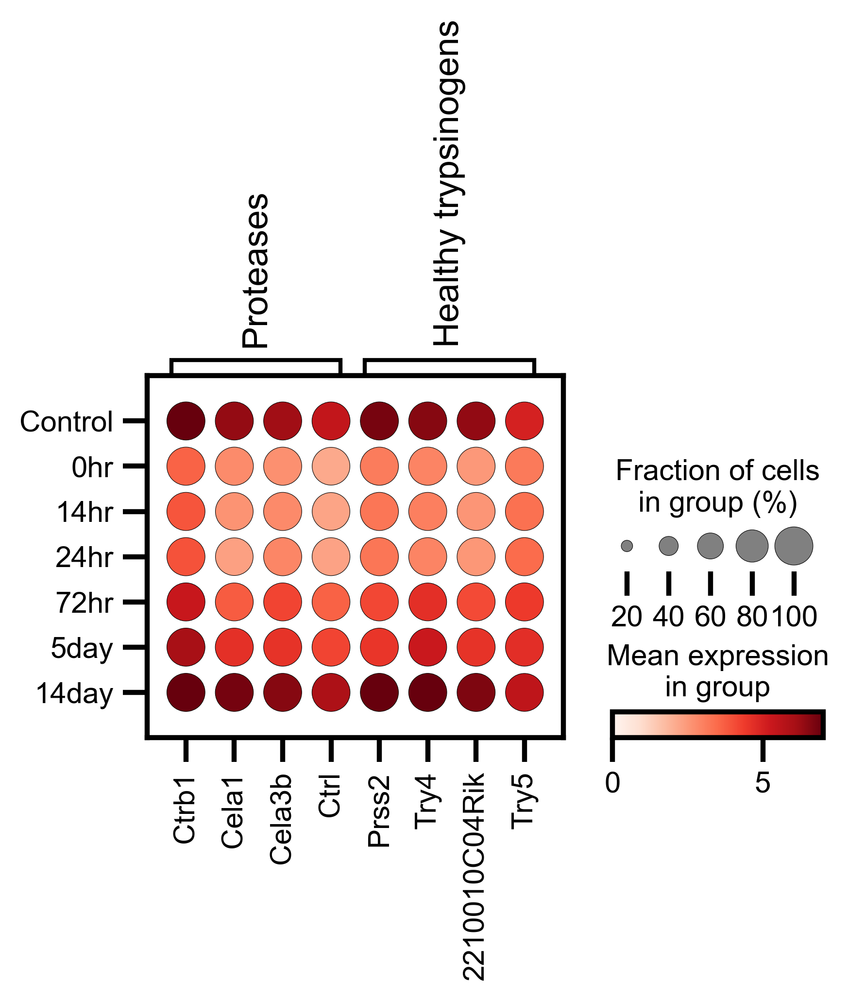

In [ ]:
fig, ax = plt.subplots(figsize=(9,4))

sc.pl.dotplot(adata1,marker_genes,"sample",layer='PFlog1pPF_normalization', vmin= 0, vmax= 7)

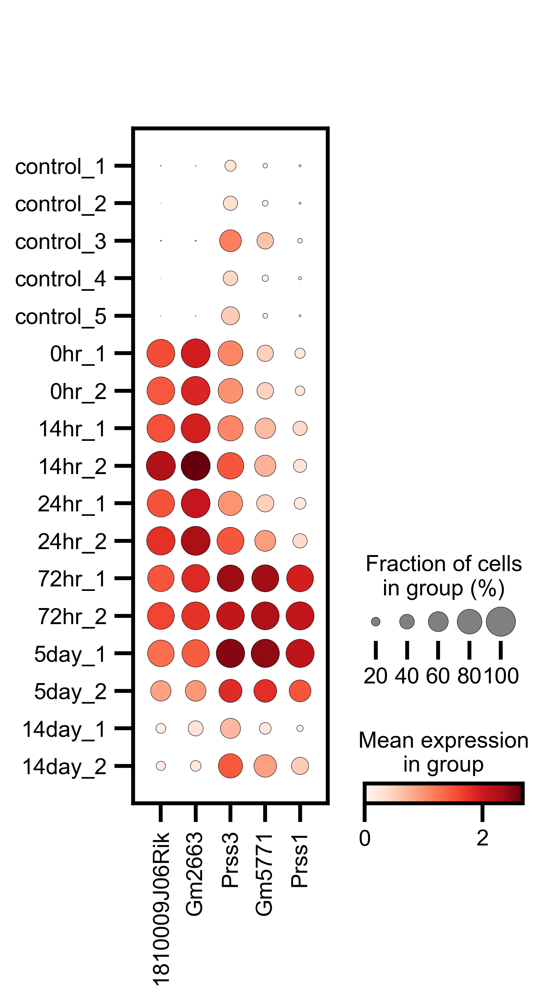

In [ ]:
lasting_changes=['1810009J06Rik', 'Gm2663', 'Prss3', 'Gm5771', 'Prss1']

sc.pl.dotplot(adata1,lasting_changes,"donor",layer='PFlog1pPF_normalization')

In [ ]:
# Extract the results
results_df = sc.get.rank_genes_groups_df(
    adata1,
    group="ADM-early",
    key=f"wilcoxon_rank_groups_annotated",
)


# Identify genes with a logfoldchange > 2
# upregulated_genes = results_df[results_df["logfoldchanges"] > 10]["names"].tolist()

# Identify genes with a logfoldchange > 2 and scores > 20
upregulated_genes_early = results_df[(results_df["logfoldchanges"] > 2) & (results_df["scores"] > 20)]["names"].tolist()


len(upregulated_genes_early)

93

In [ ]:
# Extract the results
results_df = sc.get.rank_genes_groups_df(
    adata1,
    group="ADM-late",
    key=f"wilcoxon_rank_groups_annotated",
)


# Identify genes with a logfoldchange > 2
# upregulated_genes = results_df[results_df["logfoldchanges"] > 10]["names"].tolist()

# Identify genes with a logfoldchange > 10 and scores > 50
upregulated_genes_late = results_df[(results_df["logfoldchanges"] > 2) & (results_df["scores"] > 8)]["names"].tolist()


In [ ]:
#upregulated genes in ADM late only
upregulated_genes_early=['Spc24', 'Lgals3bp', 'Ube2c', 'Gm5771', 'Birc5', 'Prss3', 'Gm10334', 'Hmgb2', 'Prss1', 'Gc', 'Hist1h1e', 'Stmn1', 'Tdh', 'Pcolce', 'Tuba1b']

In [ ]:
# Convert the lists to sets, merge them, and then convert back to a list
upregulated_genes = list(set(upregulated_genes_early) | set(upregulated_genes_late))

print(upregulated_genes)

['Tpm1', 'H2-D1', 'Tspo', 'Prss3', 'Bzw1', '1810009J06Rik', 'Gc', '2200002D01Rik', 'Tuba1b', '1110038B12Rik', 'Lgals3bp', 'Clic1', 'Gm10334', 'Reg3g', 'Tmsb4x', 'Actb', 'Actn1', 'Cdc42', 'Ywhah', 'Hexb', 'Cnih4', 'Tagln2', 'Fdps', 'Zfas1', 'Cd9', 'Cdc42ep5', 'Anxa3', 'Hist1h1e', 'Tmsb10', 'Tpm3', 'Sqstm1', 'Lrrfip2', 'Cdkn1a', 'Dnaja1', 'Epcam', 'S100a10', 'Cct8', 'Serpinb6a', 'Krt8', 'Prss1', 'Cldn4', 'Gm4744', 'Krt18', 'Efhd2', 'Arpc2', 'Cd47', 'H2-K1', 'Ube2c', 'Cmss1', 'Plp2', 'Gm5771', 'S100a11', 'Pabpn1', 'Lgals3', 'Snrpf', 'Pmm1', 'Reg3b', 'Ucp2', 'Cstb', 'Krt19', 'Gm15564', 'Gm2663', 'Sat1', 'Cdk8', 'Rtn4', 'Spc24', 'Reg3a', 'Hnrnpa1', 'Birc5', 'Hmgn1', 'Ube2i', 'Zyx', 'Pcolce', 'Dstn', 'Stmn1', 'Ethe1', 'Anxa2', 'Tdh', 'Psme1', 'Hsp90ab1', 'Tspan1', 'Sfn', 'Arpc1b', 'Cldn7', '2410006H16Rik', 'Lars2', 'Fxyd5', 'Actg1', 'Ldha', 'Hnrnpu', 'Camk1d', 'Hmgb2', 'Hnrnpc', 'Anxa5', 'Tnfrsf12a', 'Sh3bgrl3', 'Acadl', 'Myl12a', 'Cdh1', 'Reg2', 'Npm1', 'Tpm4', 'Hspa8', 'Itgb1', 'Snhg12', '

In [ ]:
Geomx24 = pd.read_csv("/content/drive/MyDrive/CIP_v3_data/CIP_all/FullDataset/SupplementaryTable3_24hr_vs_control.csv")
Geomx12 = pd.read_csv("/content/drive/MyDrive/CIP_v3_data/CIP_all/FullDataset/SupplementaryTable3_12hr_vs_control.csv")

In [ ]:
# Create a new DataFrame with 'genes' as the single column
new_table = pd.DataFrame(upregulated_genes, columns=['genes'])

# Merge the new table with results_df on the gene names
new_table = pd.merge(new_table,
                     results_df[['names', 'scores', 'logfoldchanges', 'pvals_adj']],
                     left_on='genes',
                     right_on='names',
                     how='left').drop(columns='names')

# Merge the new table with Geomx24 on the gene names
new_table = pd.merge(new_table,
                     Geomx24[['Target name', 'Log2', 'Adjusted pvalue']],
                     left_on='genes',
                     right_on='Target name',
                     how='left').drop(columns='Target name')


# Merge the new table with Geomx24 on the gene names
new_table = pd.merge(new_table,
                     Geomx12[['Target name', 'Log2', 'Adjusted pvalue']],
                     left_on='genes',
                     right_on='Target name',
                     how='left').drop(columns='Target name')

print(new_table)

      genes     scores  logfoldchanges      pvals_adj    Log2_x  \
0      Tpm1  31.581079        2.980092  1.230510e-214  1.264452   
1     H2-D1  33.672314        2.505819  2.693791e-244  1.424502   
2      Tspo  25.666269        2.451218  5.099680e-141  0.327650   
3     Prss3  15.679253        0.442807   3.842269e-51       NaN   
4      Bzw1  21.628317        2.122832   1.782167e-99  0.104085   
..      ...        ...             ...            ...       ...   
103   Itgb1  22.303137        2.392154  6.311728e-106  0.675603   
104  Snhg12  24.619915        2.988888  1.416584e-129       NaN   
105   Pdcd6  24.963106        2.011567  2.819426e-133  0.098018   
106     Bax  26.852385        2.263116  1.449397e-154  0.707084   
107   Hspb1  40.322865        2.900007   0.000000e+00  0.586662   

     Adjusted pvalue_x    Log2_y  Adjusted pvalue_y  
0         9.028170e-11  1.276156       7.274790e-11  
1         1.661720e-07  1.237504       1.944990e-06  
2         1.369320e-02  0.221454 

In [ ]:
# Save the DataFrame as a CSV file
new_table.to_csv('ADM-early-upreg_20score_4FC.csv', index=False)

In [ ]:
# Extract the results
results_df = sc.get.rank_genes_groups_df(
    adata1,
    group="ADM-early",
    key=f"wilcoxon_rank_groups_annotated",
)


# Identify genes with a logfoldchange > 2
# upregulated_genes = results_df[results_df["logfoldchanges"] > 10]["names"].tolist()

# Identify genes with a logfoldchange > 1.5 and scores > 20
upregulated_genes_early_extended = results_df[(results_df["logfoldchanges"] > 0.59) & (results_df["scores"] > 12)]["names"].tolist()


len(upregulated_genes_early_extended)

767

In [ ]:
# Create a new list with genes from upregulated_genes_early_extended that are not in upregulated_genes_early
remaining_genes = [gene for gene in upregulated_genes_early_extended if gene not in upregulated_genes_early]

In [ ]:
#upregulated genes in ADM late
upregulated_genes_late=['Spc24', 'Lgals3bp', 'Ube2c', 'Gm5771', 'Birc5', 'Prss3', 'Gm10334', 'Hmgb2', 'Prss1', 'Gc', 'Hist1h1e', 'Stmn1', 'Tdh', 'Pcolce', 'Tuba1b']

In [ ]:
# Create a new list with genes from upregulated_genes_early_extended that are not in upregulated_genes_early
remaining_genes = [gene for gene in remaining_genes if gene not in upregulated_genes_late]

In [ ]:
import pandas as pd

# Create a new DataFrame with 'genes' as the single column
new_table = pd.DataFrame(remaining_genes, columns=['genes'])

# Merge the new table with results_df on the gene names
new_table = pd.merge(new_table,
                     results_df[['names', 'scores', 'logfoldchanges', 'pvals_adj']],
                     left_on='genes',
                     right_on='names',
                     how='left').drop(columns='names')

# Merge the new table with Geomx24 on the gene names
new_table = pd.merge(new_table,
                     Geomx24[['Target name', 'Log2', 'Adjusted pvalue']],
                     left_on='genes',
                     right_on='Target name',
                     how='left').drop(columns='Target name')


# Merge the new table with Geomx24 on the gene names
new_table = pd.merge(new_table,
                     Geomx12[['Target name', 'Log2', 'Adjusted pvalue']],
                     left_on='genes',
                     right_on='Target name',
                     how='left').drop(columns='Target name')

print(new_table)


      genes     scores  logfoldchanges      pvals_adj    Log2_x  \
0       Clu  52.645752        1.860797   0.000000e+00  4.285039   
1      Gphn  47.603844        1.957324   0.000000e+00 -0.047467   
2      Ctsl  44.306248        1.693465   0.000000e+00  1.752905   
3    Ifitm3  39.244770        1.892002   0.000000e+00  0.867926   
4      Gas5  37.151180        1.824708  7.687697e-298       NaN   
..      ...        ...             ...            ...       ...   
669   Med28  12.042845        0.675533   3.875692e-29  0.016255   
670  Rxylt1  12.037978        1.107281   4.111234e-29 -0.063895   
671  Luc7l3  12.037408        1.093855   4.139723e-29  0.190651   
672  Elavl1  12.029384        1.608866   4.562404e-29  0.127551   
673    Vapb  12.009845        0.612488   5.779434e-29 -0.071914   

     Adjusted pvalue_x    Log2_y  Adjusted pvalue_y  
0         9.557830e-20  5.212411       2.191980e-22  
1         6.939710e-01 -0.068123       5.546229e-01  
2         1.304820e-16  2.400277 

In [ ]:
# Save the DataFrame as a CSV file
new_table.to_csv('ADM-early-upreg_12score_1.5FC.csv', index=False)

####ADM marker gene dot plots


In [ ]:
markers={'Acinar': ['Tff2', 'Sycn', 'Pnlip', 'Prss2', 'Cela1', 'Rnase1', '2210010C04Rik', 'Zg16', 'Clps', 'Cpa1',
                    'Pla2g1b', 'Cpb1', 'Cela3b', 'Ctrl', 'Gp2', 'Cela2a', 'Ctrb1', 'Cpa2', 'Try4', 'Pnliprp1'],
         'ADM-late': ['Spc24', 'Ube2c', 'Gm5771', 'Birc5', 'Prss3', 'Gm10334',
                       'Prss1', 'Gc', 'Hist1h1e',  'Tdh', 'Pcolce', 'Tuba1b','Stmn1','Lgals3bp', 'Hmgb2'],
         'ADM-early': ['Reg2', 'Reg3a', 'Reg3b', 'Gm2663', '1810009J06Rik', 'Reg3g', 'Gm4744', 'Tspan1', 'Pmm1',
 'Lgals3', 'Gm15564', 'Fxyd5', 'Cmss1', 'Ethe1', 'Lars2', 'Cdkn1a', 'Camk1d', 'Hspb1', 'Cdk8', 'Dstn',
 '2410006H16Rik', 'Sfn', 'Fdps', 'Cdc42ep5', 'Hexb', 'Zyx', 'Serpinb6a', 'Snhg12', 'Sqstm1', 'Tpm1',
 'Plp2', 'Zfas1', 'Hspa8', 'Actg1', 'Cldn4', 'Bax', 'Npm1', 'Hsp90ab1', 'Cstb', 'Efhd2', 'Krt8', '1110038B12Rik',
 'Cnih4', 'Krt19', 'Ube2i', '2200002D01Rik', 'Lrrfip2', 'Pdcd6', 'Arpc1b', 'Sat1', 'Ldha', 'Krt18', 'Cct8',
 'Actn1', 'Tmsb4x', 'Actb', 'Tnfrsf12a', 'H2-K1', 'Cdc42', 'Snrpf', 'Bzw1', 'Tmsb10', 'Tagln2', 'Anxa3', 'S100a10',
 'Ucp2', 'Ywhah', 'Hnrnpa1', 'Clic1', 'Pabpn1', 'H2-D1', 'Arpc2', 'Anxa2', 'Tpm4', 'S100a11', 'Rtn4', 'Hnrnpu',
 'Cd47', 'Cldn7', 'Myl12a', 'Tpm3', 'Itgb1', 'Dnaja1', 'Hnrnpc', 'Tspo', 'Acadl', 'Sh3bgrl3', 'Hmgn1', 'Psme1',
 'Cdh1', 'Epcam', 'Cd9', 'Anxa5'],
         'Ductal': ['Zbtb20', 'Spp1', 'Pkhd1', 'Bicc1', 'Atp1b1', 'Magi1', 'Sorbs2', 'Nfib', 'Cp', 'Tm4sf4',
                    'Apoe', 'Rora', 'Tshz2', 'Rbms3', 'Malat1', 'St3gal4', 'Shank2', 'Lurap1l', 'Ccnd1', 'Sox9']}

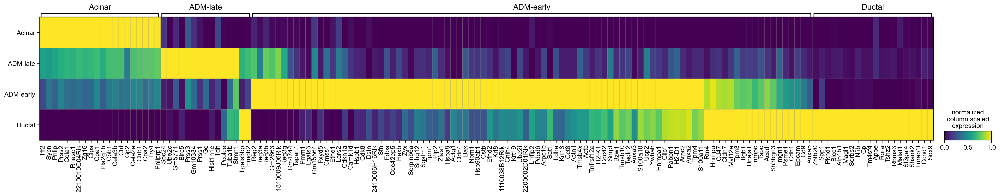

In [ ]:
sb.set_context('paper')
#savefig=samplename+"_17_markers_top5_.pdf"
sc.settings.set_figure_params(dpi=100, fontsize=14)
sc.pl.matrixplot(adata, markers, "annotated", layer='PFlog1pPF_normalization',standard_scale='var',colorbar_title='normalized\ncolumn scaled\nexpression',figsize=(30,4),var_group_rotation=0)

In [ ]:
markers_mainFig={
    'Cytoskeletal':['Actg1','Actb','Tmsb4x', 'Dstn','Npm1','Tmsb10','Cdc42', 'Arpc2','Myl12a','Arpc1b','Actn1','Cdc42ep5','Zyx',],
      'HSP': [ 'Hsp90ab1','Hspa8','Hspb1'],
    'MHC':[ 'H2-K1','H2-D1'],
    'S100':[ 'S100a11','S100a10','Anxa2'],
    'Epcam-Cldn':['Cldn7','Epcam'],
    'other': ['Cmss1',
              'Camk1d', #motility and signal transduction
              'Lars2']}


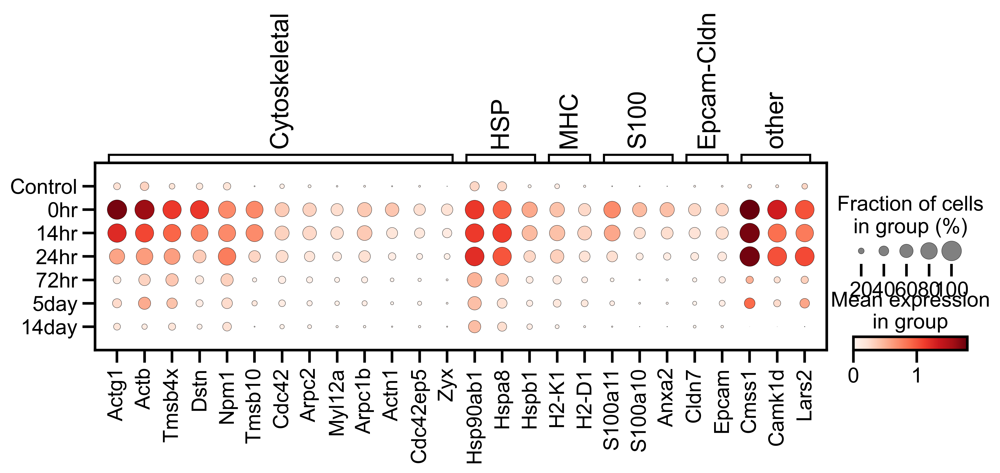

In [ ]:
# Set the default figure size
pl.rcParams['figure.figsize'] = (12, 8)  # width, height in inches

# Now call the dotplot function
sc.pl.dotplot(adata1, markers_mainFig, "sample", layer='PFlog1pPF_normalization', vmin=0, #swap_axes=True
              )

# Reset to default (optional)
pl.rcParams['figure.figsize'] = plt.rcParamsDefault['figure.figsize']

In [ ]:
from matplotlib.legend_handler import HandlerNpoints
markers_suppFig1={
        'Cytoskeletal':['Serpinb6a',
                    'Cstb',
                    'Sqstm1',#LABELED IN FIG X
                    'Cdh1',#LABELED IN FIG X
                    'Anxa3','Anxa5','Ywhah','Hnrnpu',
                    'Itgb1',#LABELED IN FIG X
                    'Cd47',
                    'Fxyd5',#LABELED IN FIG X
                    'Stmn1', 'Gc', 'Tuba1b', #ADM-late only #SOME LABELED in FIG XX
                    'Tpm1','Tpm4','Tpm3'],
    'Stress response /chaperones':['Dnaja1','Cct8','Hnrnpa1','Hnrnpc',
                                  'Hmgb2', #hormone, cell motility, extracellular space #ADM late
                                  'Pdcd6',  #movement/motility, protein/macromolecule localization, Calcium-dependent protein binding, Protein homodimerization activity
                                  ],
    'Metabolism':[
         'Ldha', #hormone stimulus #LABLED
         'Acadl',
         'Ucp2', #hormone stimulus
         'Tdh'],
        'Cell cycle/apoptosis':['Cdk8',
                                'Cdkn1a',#response to hormone stimuli, protein/macromolecule localization, Ubiquitin-like protein ligase binding, Protein-containing complex binding
                                'Birc5',
                                'Bax',#cell motility, protein/macromolecule localization,Protein domain specific binding,Protein homodimerization activity/complex binding
],
        'Ubiquitin related':['Ube2i', #response to hormone stimuli, Protein domain specific binding
                     'Ube2c',  #Reg. of organelle organization, ubiquitin
 ] }


markers_suppFig2={
'ADM-early':[
             'Tagln2',
             'Lgals3', #cell motility, extracellular space,protein/macromolecule localization
             'Clic1',  #LABLED #extracellular space
              'Efhd2','Rtn4', #cell motility,protein/macromolecule localization, Ubiquitin-like, response to wound, Protein homodimerization activity/complex binding
             'Sat1','Sh3bgrl3',
             '2410006H16Rik','Gm15564', 'Hexb',#cell motility,Protein-containing complex binding,Extracellular space
             'Pmm1','Fdps','Sfn',
             'Cd9',#LABLED #motility, wound healing, extracellular space, Protein-containing complex binding
             'Tnfrsf12a', #labeled #motility, wound healing
             'Bzw1','Hmgn1', #Protein-containing complex binding
             'Pabpn1','Tspo', #hormone stimulus, motility, protein/macromolecule localization
             'Cnih4','Lrrfip2',
             'Plp2','2200002D01Rik','Snrpf', 'Psme1', 'Ethe1',  '1110038B12Rik','Zfas1','Snhg12',
],
                       'ADM-late only':['Hist1h1e',
                    'Spc24',  #Supramolecular complex
                    'Pcolce', #Protein-containing complex binding, extracellular space
                    'Lgals3bp', #extracellular space
                        ]
}



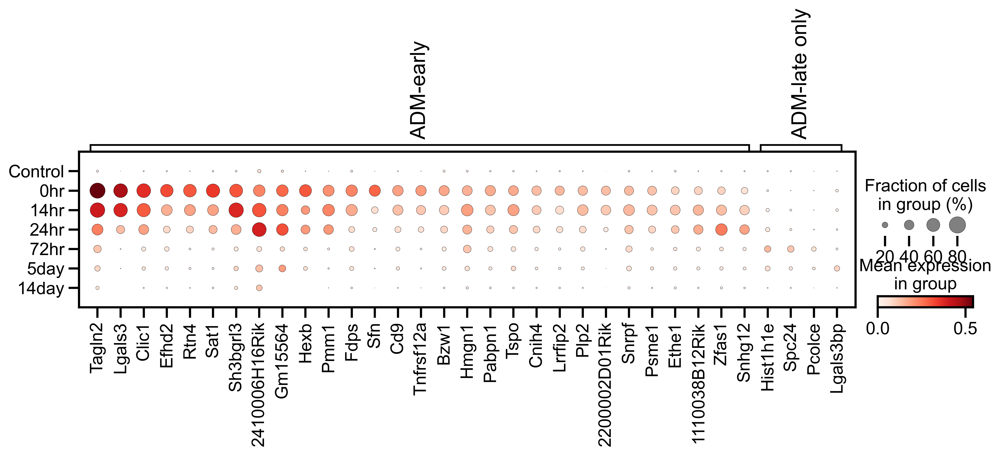

In [ ]:
# Set the default figure size
pl.rcParams['figure.figsize'] = (12, 8)  # width, height in inches

# Now call the dotplot function
sc.pl.dotplot(adata1, markers_suppFig2, "sample", layer='PFlog1pPF_normalization', vmin=0, #swap_axes=True
              )

# Reset to default (optional)
pl.rcParams['figure.figsize'] = plt.rcParamsDefault['figure.figsize']

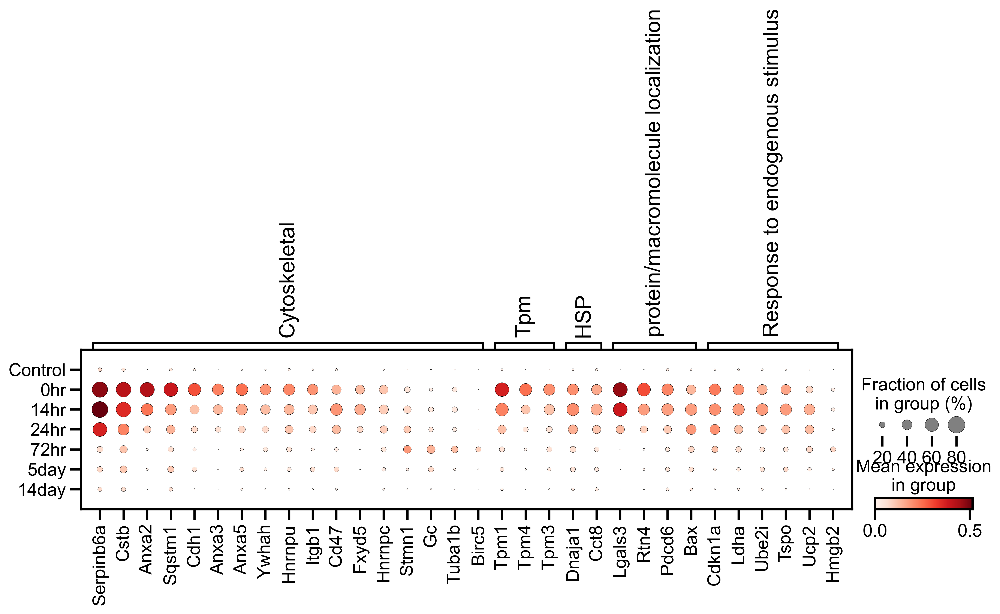

In [ ]:
# Set the default figure size
pl.rcParams['figure.figsize'] = (12, 8)  # width, height in inches

# Now call the dotplot function
sc.pl.dotplot(adata1, markers_suppFig1, "sample", layer='PFlog1pPF_normalization', vmin=0, #swap_axes=True
              )

# Reset to default (optional)
pl.rcParams['figure.figsize'] = plt.rcParamsDefault['figure.figsize']

#Pie chart


In [ ]:
# Outputs new df of the average percentage gene expression over samples from samplePD
def getAvgPercGeneExp(samplesPD):
  genes = samplesPD.iloc[:,0].tolist() # Gene names
  SAMPLES = len(samplesPD.columns) - 1 # Num of samples

  # Read sample vals by column, normalize as percentage down the column (per sample)
  cols = []
  for sample, col in samplesPD.iloc[:,1:].iteritems(): cols.append(col / np.sum(col))

  # Avg the percentages across a row (over samples)
  avgPercGeneExp = np.average(cols, axis=0)

  # Compile output
  out = []
  for i, g in enumerate(genes[:]): out.append({"gene_name": g, "avg_perc_gene_exp": avgPercGeneExp[i]})
  return pd.DataFrame(out)


In [ ]:
# Returns pds which merges gene expression values df and labels df by "gene_name"
# and one which also aggregates gene expression percentage by "group"
def mergeAndGroup(labelsPD, apgePD, cutoff, includeMissing):
  # Cutoff is % where we put into "Other" group, set to 0 if we want everything

  # Just merged on group
  mergedPD = labelsPD.merge(apgePD, on="gene_name")
  mergedGroupedPD = mergedPD.groupby(["group"], as_index=False).agg({"avg_perc_gene_exp":'sum'})

  # Cutoff applied, groups less than cutoff get accumulated as "other"
  mergedGroupedCutPD = mergedGroupedPD.copy()
  mergedGroupedCutPD.loc[mergedGroupedCutPD['avg_perc_gene_exp'] < cutoff, ['group']] = 'Other'
  mergedGroupedCutPD = mergedGroupedCutPD.groupby(["group"], as_index=False).agg({"avg_perc_gene_exp":'sum'})

  # Create whitespace for missing vals
  if includeMissing:
    missing = 1 - sum(mergedGroupedCutPD.loc[:, "avg_perc_gene_exp"])
    if missing > 0:
      mergedGroupedPD.loc[len(mergedGroupedPD.index)] = ['missing', missing]
      mergedGroupedCutPD.loc[len(mergedGroupedCutPD.index)] = ['missing', missing]
      return mergedPD, mergedGroupedPD, mergedGroupedCutPD

  return mergedPD, mergedGroupedPD, mergedGroupedCutPD

In [ ]:
# Plots the merged and grouped df as a pie chart
def applePie(grouped, legCoords, size, fontsizes, labeldist):
    f1=fontsizes[0]
    f2=fontsizes[1]

    # Font specification
    font = {'family': 'Arial', 'size': f2}
    matplotlib.rc('font', **font)

    colorBase = ["#ea5545", "#FFB6C1", "#ef9b20",  "#ede15b", "#bdcf32", "#87bc45", "#27aeef", "#b33dc6", "#b3d4ff","#00bfa0","#0066aa"]

    # Sort by average percentage gene expression, but always put "Other" last
    grouped.sort_values(by="avg_perc_gene_exp", ascending=False, inplace=True)
    other_row = grouped[grouped["group"] == "Other"]
    grouped = grouped[grouped["group"] != "Other"]
    grouped = pd.concat([grouped, other_row])

    labels = grouped.loc[:, "group"]
    percents = grouped.loc[:, "avg_perc_gene_exp"]
    percents = [str(round(p*100)) + "%" for p in percents]

    colors = dict()
    for i, label in enumerate(labels): colors[label] = colorBase[i % len(colorBase)]
    if "missing" in colors: colors["missing"] = "aliceblue"

    fig, ax = plt.subplots(figsize=size)
    wedges, texts = ax.pie(grouped.loc[:, "avg_perc_gene_exp"], colors = [colors[l] for l in labels], labels=percents, labeldistance=labeldist)

    for text in texts:
        text.set_color('black')
        text.set_fontsize(f2)

    # Legend config
    ax.legend(labels, prop=dict(size=f1), bbox_to_anchor=legCoords, loc="upper right", fontsize=f1, bbox_transform=plt.gcf().transFigure)


In [ ]:
labelsPD = pd.read_csv("/content/drive/MyDrive/CIP_v3_data/CIP_all/Acinar/piechart/AcinarGeneTranscripts_piechart_2023-04-10 (1).csv")
samplesPD = pd.read_csv("/content/drive/MyDrive/CIP_v3_data/CIP_all/Acinar/piechart/Acinar_Control_byDonor__2023-04-12_pseudobulk_Cellbender.csv")

In [ ]:
labelsPD = labelsPD.replace("Trypsin related", "Protease-related")
labelsPD = labelsPD.replace("Lipase related", "Lipase-related")
labelsPD = labelsPD.replace("metallocarboxypeptidase activity", "Metallocarboxypeptidase")

In [ ]:
grouped_labels = labelsPD.groupby('group')['gene_name'].apply(list).to_dict()

In [ ]:
grouped_labels

{'?????': ['1810028F09Rik'], 'ATP synthesis': ['Atp5o', 'Atp5j2', 'Atp5h', 'Atp5l'], 'Amino acid metabolism': ['Gcat', 'Ggt1'], 'Amylase related': ['Amy2a5', 'Amy1'], 'Apoptosis related??': ['Dap'], 'Calcium homeostasis': ['Nucb2'], 'Carbohydrate metabolism': ['Krtcap2'], 'Cell adhesion': ['Bsg'], 'Chemokine realted': ['Tff2'], 'ER related': ['Erp27', 'Reep5', 'P4hb', 'Serp1', 'Sec61b', 'Selenos'], 'G protein-coupled receptor signaling pathway': ['Gnas', 'Cckar'], 'Heat shock protein': ['Hspa5', 'Dnajc3', 'Hsp90b1'], 'Lipase-related': ['Clps', 'Pnlip', 'Pnliprp1', 'Cel', 'Pla2g1b', 'Pnliprp2'], 'Metabolic proteins': ['Serf2', 'Gatm', 'Lcmt1', 'Gamt'], 'Metallocarboxypeptidase': ['Cpb1', 'Cpa1', 'Cpa2', 'Mt2'], 'Mitochondrial': ['Mt1', 'mt-Atp6', 'mt-Co3', 'mt-Co2', 'mt-Cytb', 'mt-Co1', 'mt-Nd4', 'mt-Nd2', 'Atp5e', 'Atp5g1', 'Uqcrh', 'mt-Nd1', 'Chchd2', 'Uqcr11'], 'Motor protein??': ['Myl6'], 'Oxidation-reduction related': ['Prdx4', 'Ggh', 'Selenop', 'Msrb1', 'Gpx4'], 'Protease inhibito

In [ ]:
apgePD = getAvgPercGeneExp(samplesPD)
merged, grouped, cut = mergeAndGroup(labelsPD, apgePD, 0.01, False)
# applePie(grouped, (1, 0.7), (16,10), False, (10, 10, 10), 0.77)

<ipython-input-47-d922556b6517>:8: FutureWarning: iteritems is deprecated and will be removed in a future version. Use .items instead.


In [ ]:
applePie(cut, (0.1, 0.75), (15,20), (50, 40), 1.11)

In [ ]:
# "Prss2", "Try4", "2210010C04Rik", "Try5", "Try10"
s = 0
s += float(apgePD.loc[apgePD['gene_name'] == "Prss2"]["avg_perc_gene_exp"])
s += float(apgePD.loc[apgePD['gene_name'] == "Try4"]["avg_perc_gene_exp"])
s += float(apgePD.loc[apgePD['gene_name'] == "2210010C04Rik"]["avg_perc_gene_exp"])
s += float(apgePD.loc[apgePD['gene_name'] == "Try5"]["avg_perc_gene_exp"])
s += float(apgePD.loc[apgePD['gene_name'] == "Try10"]["avg_perc_ene_exp"])
print(s)
print(apgePD.loc[apgePD['gene_name'] == "Prss2"]["avg_perc_gene_exp"])
print(float(apgePD.loc[apgePD['gene_name'] == "Prss2"]["avg_perc_gene_exp"]))

0.236873946478826
5916    0.084266
Name: avg_perc_gene_exp, dtype: float64
0.08426550040554302


#GSEA plotting

In [ ]:
import pandas as pd

# file path
file_path = '/content/drive/MyDrive/CIP_v3_data/CIP_all/GSEA/AcinarByTimepoint_wilcoxon_Hallmark_correctedpval.csv'

# read CSV file into dataframe
gsea_results = pd.read_csv(file_path)


In [ ]:
# Sample list
samples = ['Control', '0hr', '14hr', '24hr', '72hr', '5day', '14day']

# Assuming your input DataFrame is named df
gsea_results.reset_index(inplace=True)
gsea_results = gsea_results.rename(columns={'source': 'GeneSet'})

# Initialize an empty DataFrame for the result
result = pd.DataFrame(columns=['GeneSet', 'Score', 'pval', 'sample'])

# Iterate over samples and melt the dataframe
for sample in samples:
    temp_df = gsea_results[['GeneSet', f'{sample}_score', f'{sample}_pval']]
    temp_df = temp_df.rename(columns={f'{sample}_score': 'Score', f'{sample}_pval': 'pval'})
    temp_df['sample'] = sample
    result = result.append(temp_df, ignore_index=True)

# Display the resulting DataFrame
print(result)


                                 GeneSet     Score          pval   sample
0                  HALLMARK_ADIPOGENESIS -0.610387  2.241041e-11  Control
1           HALLMARK_ALLOGRAFT_REJECTION -0.588094  6.889910e-05  Control
2             HALLMARK_ANDROGEN_RESPONSE -0.629591  1.083870e-05  Control
3                  HALLMARK_ANGIOGENESIS -0.586558  1.793417e-02  Control
4               HALLMARK_APICAL_JUNCTION -0.616020  6.406965e-07  Control
..                                   ...       ...           ...      ...
345   HALLMARK_UNFOLDED_PROTEIN_RESPONSE -0.595494  7.751951e-06    14day
346              HALLMARK_UV_RESPONSE_DN -0.509400  5.578743e-05    14day
347              HALLMARK_UV_RESPONSE_UP -0.561809  4.400743e-06    14day
348  HALLMARK_WNT_BETA_CATENIN_SIGNALING -0.543805  1.194810e-02    14day
349       HALLMARK_XENOBIOTIC_METABOLISM -0.430682  1.491385e-03    14day

[350 rows x 4 columns]


<ipython-input-30-38f6c09a69fb>:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
<ipython-input-30-38f6c09a69fb>:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
<ipython-input-30-38f6c09a69fb>:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
<ipython-input-30-38f6c09a69fb>:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
<ipython-input-30-38f6c09a69fb>:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
<ipython-input-30-38f6c09a69fb>:16: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.co

In [ ]:
lst1 = ['HALLMARK_TNFA_SIGNALING_VIA_NFKB','HALLMARK_TGF_BETA_SIGNALING', 'HALLMARK_DNA_REPAIR',
        'HALLMARK_G2M_CHECKPOINT', 'HALLMARK_APOPTOSIS', 'HALLMARK_PI3K_AKT_MTOR_SIGNALING','HALLMARK_MYC_TARGETS_V1',
        'HALLMARK_EPITHELIAL_MESENCHYMAL_TRANSITION', 'HALLMARK_KRAS_SIGNALING_UP', 'HALLMARK_OXIDATIVE_PHOSPHORYLATION',
 'HALLMARK_REACTIVE_OXIGEN_SPECIES_PATHWAY','HALLMARK_IL2_STAT5_SIGNALING' ]

# Filter the melted_data DataFrame to only include rows where Gene_Set is in lst1
result_filtered = result[result['GeneSet'].isin(lst1)]

In [ ]:
import re

# Define a function to convert text to proper case
def proper_case(text):
    lst_exceptions = ['DNA', 'E2F', 'G2M', 'UV', 'PI3K','KRAS']

    # Remove the word "HALLMARK" (case-insensitive) from any point in the text
    text = re.sub('(?i)HALLMARK', '', text)

    words = text.split('_')
    words = [word.capitalize() if word not in lst_exceptions else word for word in words]
    text = ' '.join(words)

    # Replace text after capitalization
    text = re.sub('(?i)MTORC1', 'mTORC1', text)
    text = re.sub('(?i)PI3K Akt Mtor', 'PI3K/Akt/mTOR', text)

    return text

In [ ]:
# Apply the proper_case function to the index column
result_filtered['GeneSet'] = result_filtered['GeneSet'].map(proper_case)

# Print the updated dataframe
print(result_filtered)

                                GeneSet     Score          pval   sample
6                             Apoptosis -0.604403  7.807905e-07  Control
11                           DNA Repair -0.671371  2.241041e-11  Control
13    Epithelial Mesenchymal Transition -0.479210  1.756290e-04  Control
17                       G2M Checkpoint -0.550087  1.320717e-08  Control
22                  Il2 Stat5 Signaling -0.565836  2.355051e-06  Control
..                                  ...       ...           ...      ...
335           Oxidative Phosphorylation -0.476107  1.098291e-07    14day
339             PI3K/Akt/mTOR Signaling -0.687877  3.934543e-07    14day
341     Reactive Oxigen Species Pathway -0.413442  3.994094e-02    14day
343                  Tgf Beta Signaling -0.654299  1.875684e-04    14day
344             Tnfa Signaling Via Nfkb -0.588148  7.750765e-08    14day

[84 rows x 4 columns]


<ipython-input-33-091262160733>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


In [ ]:
result_filtered['GeneSet'] = result_filtered['GeneSet'].replace({'Tnfa': 'Tnfα', 'Tgf Beta': 'Tgfβ'}, regex=True)

<ipython-input-23-6d28f5bbe1b0>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


<ipython-input-24-31c251297eef>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-24-31c251297eef>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-24-31c251297eef>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
<ipython-input-24-31c251297e

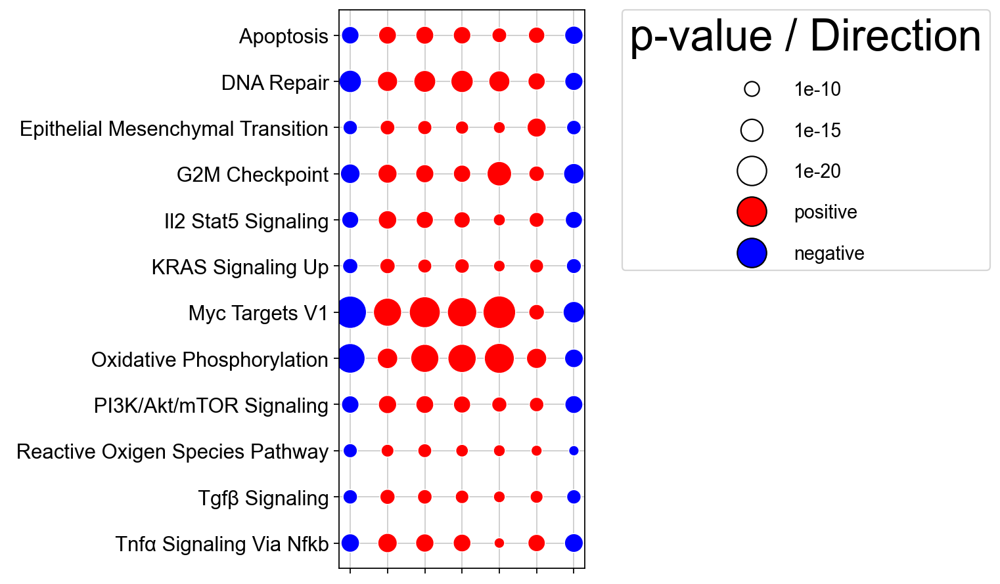

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Increase the font size of the written text
plt.rcParams.update({'font.size': 30})

# Add new columns to the DataFrame for color and size
result_filtered['color'] = np.where(result_filtered['Score'] > 0, 'positive', 'negative')

# Convert the 'pval' column to a numeric type and calculate log10
result_filtered['pval'] = pd.to_numeric(result_filtered['pval'], errors='coerce')
result_filtered['size'] = -np.log10(result_filtered['pval'].dropna())

# Create a custom color palette for positive and negative scores
palette = {'positive': 'red', 'negative': 'blue'}

# Create the bubble plot
plt.figure(figsize=(3, 7))
ax = sns.scatterplot(data=result_filtered, x='sample', y='GeneSet', hue='color', size='size', sizes=(50, 500), palette=palette)

# Customize the legend
legend_labels = ["1e-10","1e-15","1e-20"]
legend_sizes = [-np.log10(float(label)) for label in legend_labels]
pval_elements = [plt.Line2D([0], [0], marker='o', color='w', markersize=size, markeredgecolor='black', label=label) for size, label in zip(legend_sizes, legend_labels)]

# Color legend elements
color_elements = [plt.Line2D([0], [0], marker='o', color=color, markersize=20, markeredgecolor='black', label=label) for label, color in palette.items()]

# Combine p-value and color legend elements
legend_elements = pval_elements + color_elements

# Add the customized legend to the plot
ax.legend(handles=legend_elements, title="p-value / Direction", bbox_to_anchor=(1.15, 1), loc='upper left', borderaxespad=0., labelspacing=1.2, handletextpad=2)

# Set labels for the axes
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
plt.xlabel('')
plt.ylabel('')

# Set the grid lines behind the dots
ax.set_axisbelow(True)

# Display the plot
plt.show()



#Gene list for Calligraphy

In [ ]:
# Extract the results
results_df = sc.get.rank_genes_groups_df(
    adata1,
    group="ADM-early",
    key=f"wilcoxon_rank_groups_annotated",
)


# Identify genes with a logfoldchange > 2
# upregulated_genes = results_df[results_df["logfoldchanges"] > 10]["names"].tolist()

# Identify genes with a logfoldchange > 1.5 and scores > 3
upregulated_genes_early_extended = results_df[(results_df["logfoldchanges"] > 0.59) & (results_df["scores"] > 3)]["names"].tolist()